In [1]:
import scanpy as sc
import os
import anndata
import numpy as np
import pandas as pd
import seaborn as sns
import muon as mu
import warnings
import matplotlib.pyplot as plt
from matplotlib.pyplot import rc_context
import torch
import scvi
import scanpy.external as sce
import faiss
from scipy.sparse import issparse
from scipy.stats import gaussian_kde
from sklearn.preprocessing import Binarizer
import matplotlib.colors as mcolors
import matplotlib.cm as cm
from paretoset import paretoset
from adjustText import adjust_text
import scipy
import anndata as ad
import matplotlib

/home/sina.kanannejad/miniconda3/envs/pertpy-env/lib/python3.11/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


In [2]:
import warnings
warnings.filterwarnings('ignore')

In [3]:
matplotlib.rcParams['pdf.fonttype'] = 42
matplotlib.rcParams['ps.fonttype'] = 42

In [58]:
sc._settings.settings._vector_friendly=True
sc.settings.verbosity = 0
sc.settings.set_figure_params(
    dpi=300,dpi_save = 300,
    facecolor="white",
    frameon=True, fontsize = 8
)
sc.settings.figdir = "/Fig_5_6/"
sns.set_theme(style="white")

In [5]:
LSC_colors = {
    'P-LSC': 'darkred', 
    "Patient Specific" : "grey",
    'M-LSC': '#2ca02c',  
    "E-LSC" : "purple"
}

leiden_COLORS = {
    '1': '#E41A1C',  # red
    '2': '#377EB8',     # blue
    '3': '#984EA3',            # changed to purple
    '4': '#66C2A5',      # changed to mint
    '5': '#FF7F00',           # orange
    '6': '#FFFF33',        # yellow
    '7': '#A65628',        # brown
    '8': '#F781BF',       # pink
    '9': '#E6AB02',     # changed to gold
    '10': '#A6D854',      # changed to lime
    '11': '#FC8D62',       # coral
    '0': '#8DA0CB'          # light blu
}

color_dict_samples = {
    'AML3': 'darkred',
    'AML4': 'red',
    'AML5': 'tomato',
    'AML6': 'sienna',
    'AML7': 'darkorange',
    'AML8': '#8C564B',
    'AML9_Dx': 'gold',
    'AML9_Rel': 'seagreen',
    'AML10_Dx': 'khaki',
    'AML10_Rel': 'forestgreen',
    'AML11_Dx': 'darkviolet',
    'AML11_Rel': 'teal',
    'AML12_Dx': '#2CA02C',
    'AML12_Post': '#D62728',
    'AML12_Rel': '#9467BD',
    'AML13_Dx': '#8C564B',
    'AML13_Post': '#E377C2',
    'AML13_Rel': '#7F7F7F',
    'AML14_Dx': '#BCBD22',
    'AML14_Rel': '#17BECF',
    'AML15_Dx': '#FF33CC',
    'AML15_Rel': '#33CCFF',
    'CB1': 'grey',
    'CB2': 'grey',
    'HD1': 'grey',
    'HD2': 'grey',
    'PBM': 'grey'
    }

color_dict_cyto = {'NUP98r': 'brown',
    'GLIS2': 'red',
    'DEK_NUP214': 'blue',
    'MNX1': 'olive',
    'KMT2Ar': 'green',
    'RUNX1_RUNX1T1': 'violet',
    'CBFB_MYH11': 'indigo',
    'Healthy': 'lightgrey',
    'unknown': 'tan'
    }

color_dict_state = {'Dx': 'teal',
    'relapse': 'maroon',
    'Healthy': 'tan',
    'post': 'navy'
    }


color_dict_state_major = {'AML': 'maroon',
    'Healthy': 'lightblue'

    }

color_dict_sample_broad = {
    'AML3': 'green',
    'AML4': 'red',
    'AML5': 'crimson',
    'AML6': 'orange',
    'AML7': 'navy',
    'AML8': 'blue',
    'AML9': 'skyblue',
    'AML10': 'brown',
    'AML11': 'khaki',
    'AML12': 'coral',
    'AML13': 'magenta',
    'AML14': 'darkmagenta',
    'AML15': 'olive',
    'AML16': 'purple',
    'AML17': 'teal',
    'AML19': 'goldenrod',   # Changed from darkgreen to be more distinct from AML3
    'Healthy': 'lightgrey',
}

color_dict_LSC2 = {'High_LSC_score': 'brown',
    'Medium_LSC_score': 'rosybrown',
    'Low_LSC_score': 'green',
    'HSCs': 'blue',
    }

Malignant_normal = {'Malignant': 'brown',
    'Normal': "lightblue"
    } 

color_dict = {
    'CD371_ADT_negIL1RAP-1_ADT_neg': '#cccccc',  # light gray (double negative)
    'CD371_ADT_negIL1RAP-1_ADT_pos': '#1f77b4',  # blue (IL1RAP-1 only positive)
    'CD371_ADT_posIL1RAP-1_ADT_neg': '#ff7f0e',  # orange (CD371 only positive)
    'CD371_ADT_posIL1RAP-1_ADT_pos': '#2ca02c',  # green (double positive)
}

In [46]:
def rna_embeddings(adata, sorted_weights, batch_key="sample"):

    # Use log-normalized counts
    adata.X = adata.layers["lognorm_counts"].copy()

    # Subset to desired gene set
    adata = adata[:, adata.var_names.isin(sorted_weights)].copy()

    # PCA
    sc.tl.pca(adata)

    # Harmony integration
    sce.pp.harmony_integrate(
        adata, 
        key=batch_key, 
        max_iter_harmony=20
    )

    # Build neighborhood graph on integrated space
    sc.pp.neighbors(adata, use_rep="X_pca_harmony",metric='cosine',
                    n_neighbors=int(0.5 * len(adata) ** 0.5))

    # Compute UMAP
    sc.tl.umap(adata, min_dist=0.2)

    # Save to custom slot
    adata.obsm["UMAP_harmony_rna"] = adata.obsm["X_umap"]

    return adata

def plot_stacked_barplot(adata, groupby_columns, color_dict, figsize=(10, 10), 
                        group_order=None, save_path=None, dpi=300, format='pdf'):
    """
    Plots a horizontal stacked barplot with custom group (y-axis) order.
    
    Parameters:
    -----------
    adata : AnnData object
        Annotated data matrix.
    groupby_columns : list
        List containing two strings specifying the `obs` columns to group by.
    color_dict : dict
        Dictionary mapping categories in the second group to colors.
    figsize : tuple
        Figure size (default: (10, 10)).
    group_order : list, optional
        List specifying the order of groups on y-axis.
    save_path : str, optional
        Path to save the figure (e.g., '/path/to/figure.pdf').
    dpi : int
        Resolution for saved figure (default: 300).
    format : str
        File format for saving (default: 'pdf').
        
    Returns:
    --------
    fig, ax : matplotlib figure and axes objects
    """
    group, count = groupby_columns
    
    # Create a DataFrame with group counts
    df = adata.obs.groupby(groupby_columns).size().reset_index(name='count')
    
    # Normalize within each group
    df['percent'] = df.groupby(group)['count'].apply(lambda x: 100 * x / x.sum()).reset_index(drop=True)
    
    # Pivot for plotting
    pivot_df = df.pivot(index=group, columns=count, values='percent').fillna(0)
    
    # Reorder the index (y-axis) if group_order is provided
    if group_order is not None:
        # Ensure all groups in order exist in the data
        valid_groups = [g for g in group_order if g in pivot_df.index]
        pivot_df = pivot_df.reindex(valid_groups)
    
    # Ensure correct color mapping
    colors = [color_dict.get(c, "gray") for c in pivot_df.columns]
    
    # Create figure
    fig, ax = plt.subplots(figsize=figsize)
    
    # Plot horizontal bars
    pivot_df.plot(kind='barh', stacked=True, figsize=figsize, color=colors, width=0.7, ax=ax)
    
    # Customize plot
    plt.xlabel("Percentage")
    plt.ylabel(group)
    plt.legend(title=count, bbox_to_anchor=(1, 0.5))
    plt.title(f"Distribution of {count} by {group}")
    
    # Remove top and right spines
    ax.spines['top'].set_visible(False)
    ax.spines['right'].set_visible(False)
    
    # Add grid lines
    ax.grid(axis='x', linestyle='--', alpha=0.7)
    
    # Adjust layout to prevent label cutoff
    plt.tight_layout()
    
    # Save figure if path is provided
    if save_path:
        plt.savefig(save_path, format=format, dpi=dpi, bbox_inches='tight')
        print(f"Figure saved to: {save_path}")
    
    plt.show()
    
    return fig, ax

import matplotlib.pyplot as plt
import seaborn as sns
import pandas as pd
import numpy as np

def plot_leiden_sample_enrichment(adata, leiden_col='leiden', sample_col='sample', 
                                 figsize=(12, 8), save_path=None, dpi=300,
                                 plot_type='box', color_palette='Set3'):
    """
    Plot enrichment of leiden clusters across samples.
    
    Parameters:
    -----------
    adata : AnnData
        AnnData object.
    leiden_col : str
        Column name for leiden clusters in adata.obs.
    sample_col : str
        Column name for samples in adata.obs.
    figsize : tuple
        Figure size (width, height).
    save_path : str, optional
        Path to save the plot.
    dpi : int
        Resolution for saved plot.
    plot_type : str
        Type of plot: 'box', 'violin', 'bar', or 'heatmap'.
    color_palette : str
        Color palette for the plot.
    """
    
    # Check if columns exist
    if leiden_col not in adata.obs.columns:
        raise ValueError(f"Leiden column '{leiden_col}' not found in adata.obs.")
    
    if sample_col not in adata.obs.columns:
        raise ValueError(f"Sample column '{sample_col}' not found in adata.obs.")
    
    # Create contingency table
    contingency = pd.crosstab(adata.obs[leiden_col], adata.obs[sample_col])
    
    # Calculate enrichment (percentage of each cluster in each sample)
    enrichment = contingency.div(contingency.sum(axis=0), axis=1) * 100
    
    # Create long format for plotting
    enrichment_long = enrichment.reset_index().melt(
        id_vars=leiden_col, 
        var_name=sample_col, 
        value_name='Percentage'
    )
    
    # Get unique values for ordering
    leiden_clusters = sorted(adata.obs[leiden_col].unique())
    samples = sorted(adata.obs[sample_col].unique())
    
    print(f"Found {len(leiden_clusters)} leiden clusters and {len(samples)} samples")
    print(f"Enrichment matrix shape: {enrichment.shape}")
    
    if plot_type == 'box':
        plot_box_enrichment(enrichment_long, leiden_col, sample_col, figsize, 
                          color_palette, save_path, dpi)
    
    elif plot_type == 'violin':
        plot_violin_enrichment(enrichment_long, leiden_col, sample_col, figsize, 
                             color_palette, save_path, dpi)
    
    elif plot_type == 'bar':
        plot_bar_enrichment(enrichment_long, leiden_col, sample_col, figsize, 
                          color_palette, save_path, dpi)
    
    elif plot_type == 'heatmap':
        plot_heatmap_enrichment(enrichment, figsize, save_path, dpi)
    
    else:
        raise ValueError("plot_type must be 'box', 'violin', 'bar', or 'heatmap'")
    
    return

def plot_box_enrichment(enrichment_long, leiden_col, sample_col, figsize, 
                       color_palette, save_path, dpi):
    """Create box plot of enrichment."""
    
    plt.figure(figsize=figsize)
    
    # Create box plot
    sns.boxplot(data=enrichment_long, x=leiden_col, y='Percentage', 
               hue=sample_col, palette=color_palette)
    
    plt.title(f'Leiden Cluster Enrichment by Sample', fontsize=14, fontweight='bold')
    plt.xlabel('Leiden Cluster', fontsize=12)
    plt.ylabel('Percentage of Sample (%)', fontsize=12)
    plt.xticks(rotation=45)
    plt.legend(title='Sample', bbox_to_anchor=(1.05, 1), loc='upper left')
    plt.grid(True, alpha=0.3)
    plt.tight_layout()
    
    if save_path:
        plt.savefig(save_path, dpi=dpi, bbox_inches='tight')
        print(f"Plot saved to {save_path}")
    
    plt.show()

def plot_heatmap_enrichment(enrichment, figsize, save_path, dpi):
    """Create heatmap of enrichment."""
    
    plt.figure(figsize=figsize)
    
    # Create heatmap
    sns.heatmap(enrichment, annot=True, fmt='.1f', cmap='PuBu', 
               cbar_kws={'label': 'Percentage (%)'})
    
    #plt.title(f'Leiden Cluster Enrichment Heatmap', fontsize=14, fontweight='bold')
    plt.xlabel('Sample', fontsize=12)
    plt.ylabel('Leiden Cluster', fontsize=12)
    plt.tight_layout()
    
    if save_path:
        plt.savefig(save_path, dpi=dpi, bbox_inches='tight')
        print(f"Plot saved to {save_path}")
    
    plt.show()
    

import numpy as np

def annotate_gene_expression_bin(adata, gene_list, layer):
    """
    Adds a binary status column to `adata.obs` for each gene in `gene_list`.
    Each column is named '{gene}_bin' and contains values '{gene}_pos' or '{gene}_neg'
    depending on whether expression > 1 in the specified `layer`.
    
    Parameters:
    - adata: AnnData object
    - gene_list: list of gene names (must be in adata.var_names)
    - layer: name of the layer to use for expression values
    """
    for gene in gene_list:
        if gene not in adata.var_names:
            raise ValueError(f"Gene '{gene}' not found in adata.var_names.")
        
        gene_idx = adata.var_names.get_loc(gene)
        expression_values = adata.layers[layer][:, gene_idx]
        
        if not isinstance(expression_values, np.ndarray):
            expression_values = expression_values.toarray()
        
        status = np.where(expression_values > 0, f"{gene}_pos", f"{gene}_neg")
        adata.obs[f"{gene}_bin"] = status

def plot_marker_ecf_and_positivity(
    adata,
    markers,
    layer="raw_counts",
    threshold=0,
    figsize=(6, 4),
    bar_color="tab10",save_path=None, dpi=300, format='png'
):
    """
    For one or two markers, compute ECF and plot number of positive/negative cells.
    For two markers, also show both/either/only one positive.

    Parameters
    ----------
    adata : AnnData
        AnnData object.
    markers : list of str
        List of 1 or 2 marker names (must be in adata.var_names).
    layer : str
        Layer to use for counts.
    threshold : float
        Threshold above which a cell is considered positive.
    figsize : tuple
        Figure size for the plot.
    bar_color : str
        Matplotlib color palette name.

    Returns
    -------
    None
    """

    if not all(m in adata.var_names for m in markers):
        raise ValueError("All markers must be in adata.var_names")

    # Get data
    X = adata.layers[layer]
    if scipy.sparse.issparse(X):
        X = X.toarray()
    marker_idx = [adata.var_names.get_loc(m) for m in markers]
    marker_counts = X[:, marker_idx]

    # Binarize
    bin_M = (marker_counts > threshold).astype(int)
    n_cells = bin_M.shape[0]

    # Calculate ECF
    ECF = np.sum(bin_M, axis=0) / n_cells

    # Plotting
    if len(markers) == 1:
        n_pos = bin_M.sum()
        n_neg = n_cells - n_pos
        counts = [n_neg, n_pos]
        labels = ["Negative", "Positive"]
        plt.figure(figsize=(3,2))
        ax = sns.barplot(
            x=labels,
            y=counts,
            palette=sns.color_palette(bar_color, 2),width=0.5
        )
        #plt.title(f"{markers[0]}: ECF={ECF[0]:.2f}")
        plt.ylabel("Number of cells")
        # Annotate bars
        for i, count in enumerate(counts):
            percent = 100 * count / n_cells
            ax.text(i, count, f"{count}\n({percent:.1f}%)", ha='center', va='bottom', fontsize = 8)
        if save_path:
            plt.savefig(save_path, format=format, dpi=dpi, bbox_inches='tight')
            print(f"Figure saved to: {save_path}")    
        plt.show()
    elif len(markers) == 2:
        m1, m2 = markers
        pos1 = bin_M[:, 0].astype(bool)
        pos2 = bin_M[:, 1].astype(bool)
        both_pos = pos1 & pos2
        either_pos = pos1 | pos2
        only1 = pos1 & ~pos2
        only2 = pos2 & ~pos1
        neither = ~(pos1 | pos2)

        counts = {
            f"{m1} only": only1.sum(),
            f"{m2} only": only2.sum(),
            "&": both_pos.sum(),
            "or": either_pos.sum(),
            "None": neither.sum()
        }

        plt.figure(figsize=figsize)
        ax = sns.barplot(
            x=list(counts.keys()),
            y=list(counts.values()),
            palette=sns.color_palette(bar_color, len(counts)),width=0.6
        )
        #plt.title(f"{m1} ECF={ECF[0]:.2f}, {m2} ECF={ECF[1]:.2f}")
        plt.ylabel("Number of cells")
        plt.xticks(rotation=90)
        # Annotate bars
        for i, (label, count) in enumerate(counts.items()):
            percent = 100 * count / n_cells
            ax.text(i, count, f"{count}\n({percent:.1f}%)", ha='center', va='bottom', fontsize = 8)
        sns.despine(top=True)
        plt.tight_layout()
        
        if save_path:
            plt.savefig(save_path, format=format, dpi=dpi, bbox_inches='tight')
            print(f"Figure saved to: {save_path}")
        
        plt.show()
    else:
        raise ValueError("Only 1 or 2 markers supported.")

    # Optionally, return ECF and counts
    return ECF
def plot_boxplot_with_stats_gene(adata, categorical_col, gene_name, layer='X', figsize=(8, 6), 
                                palette=None, jitter=True, alpha=0.4, save_path=None, 
                                dpi=300, format='pdf'):
    """
    Create a boxplot with statistical significance markers for gene expression from AnnData object.
    
    Parameters:
    -----------
    adata : AnnData
        Annotated data object
    categorical_col : str
        Column name for categorical variable in adata.obs
    gene_name : str
        Gene name to plot expression for
    layer : str
        Layer name to extract gene expression from (default: 'X')
    figsize : tuple
        Figure size (width, height)
    palette : str or list
        Color palette for the plot
    jitter : bool
        Whether to add jittered points
    alpha : float
        Transparency for jittered points
    save_path : str, optional
        Path to save the figure (e.g., '/path/to/figure.pdf')
    dpi : int
        Resolution for saved figure (default: 300)
    format : str
        File format for saving (default: 'pdf')
    
    Returns:
    --------
    dict: Statistical test results
    """
    from scipy import stats
    import matplotlib.pyplot as plt
    import seaborn as sns
    import numpy as np
    
    # Check if gene exists in the data
    if gene_name not in adata.var_names:
        raise ValueError(f"Gene '{gene_name}' not found in adata.var_names")
    
    # Get gene expression data from specified layer
    if layer == 'X':
        gene_expr = adata[:, gene_name].X.toarray().flatten() if hasattr(adata[:, gene_name].X, 'toarray') else adata[:, gene_name].X.flatten()
    else:
        if layer not in adata.layers:
            raise ValueError(f"Layer '{layer}' not found in adata.layers")
        gene_expr = adata[:, gene_name].layers[layer].toarray().flatten() if hasattr(adata[:, gene_name].layers[layer], 'toarray') else adata[:, gene_name].layers[layer].flatten()
    
    # Create a temporary dataframe for plotting
    plot_data = adata.obs.copy()
    plot_data[gene_name] = gene_expr
    
    # Clear any existing plots
    plt.clf()
    plt.close('all')
    
    # Create figure
    plt.figure(figsize=figsize)
    
    # Remove seaborn grid style
    sns.set_style("whitegrid")
    
    # Create boxplot
    if jitter:
        ax = sns.boxplot(data=plot_data, x=categorical_col, y=gene_name, 
                        palette=palette, showfliers=False)
        sns.stripplot(data=plot_data, x=categorical_col, y=gene_name, 
                     color='black', alpha=alpha, size=3)
    else:
        ax = sns.boxplot(data=plot_data, x=categorical_col, y=gene_name, 
                        palette=palette)
    
    # Remove all grids explicitly
    ax.grid(False)
    ax.set_axisbelow(False)
    
    # Get unique categories
    categories = plot_data[categorical_col].unique()
    
    # Initialize variables for statistical test
    stat = None
    pval = None
    
    # Perform statistical test
    if len(categories) >= 2:
        # For 2 categories: Mann-Whitney U test
        if len(categories) == 2:
            cat1_data = plot_data[plot_data[categorical_col] == categories[0]][gene_name]
            cat2_data = plot_data[plot_data[categorical_col] == categories[1]][gene_name]
            
            stat, pval = stats.mannwhitneyu(cat1_data, cat2_data, alternative='two-sided')
            test_name = "Mann-Whitney U test"
            
            # Determine significance symbol
            if pval < 0.001:
                sig_symbol = '***'
            elif pval < 0.01:
                sig_symbol = '**'
            elif pval < 0.05:
                sig_symbol = '*'
            else:
                sig_symbol = 'ns'
            
            # Get data for y-axis positioning
            y_max = max(cat1_data.max(), cat2_data.max())
            y_min = min(cat1_data.min(), cat2_data.min())
            y_range = y_max - y_min
            
            # Add significance bar
            bar_height = y_max + y_range * 0.1
            bar_tips = y_max + y_range * 0.05
            
            # Plot the significance bar
            plt.plot([0, 0, 1, 1], 
                    [bar_tips, bar_height, bar_height, bar_tips], 
                    'k-', linewidth=1)
            
            # Add the significance asterisks
            plt.text(0.5, bar_height + y_range * 0.02, 
                    sig_symbol, 
                    ha='center', va='bottom',
                    fontsize=12)
            
            # Update y-axis limits to show significance bar
            plt.ylim(y_min - y_range * 0.1, bar_height + y_range * 0.15)
            
            # Print statistical test results
            print(f"\n{test_name} results:")
            print(f"p-value: {pval:.2e}")
            print(f"Significance: {sig_symbol}")
            
        else:
            # For more than 2 categories: Kruskal-Wallis H-test
            groups = [group for name, group in plot_data.groupby(categorical_col)[gene_name]]
            stat, pval = stats.kruskal(*groups)
            print(f"\nKruskal-Wallis H-test results:")
            print(f"p-value: {pval:.2e}")
    
    # Customize plot
    plt.title(f'{gene_name} expression by {categorical_col}')
    plt.ylabel(f'{gene_name} expression')
    
    # Remove any remaining grid elements
    plt.grid(False)
    ax.spines['top'].set_visible(False)
    ax.spines['right'].set_visible(False)
    
    # Add number of samples in each category (commented out as in original)
    #n_samples = plot_data[categorical_col].value_counts()
    #xlabel_text = [f'{cat}\n(n={n_samples[cat]})' for cat in categories]
    #plt.gca().set_xticklabels(xlabel_text)
    
    plt.tight_layout()
    
    # Save figure if path is provided
    if save_path:
        plt.savefig(save_path, format=format, dpi=dpi, bbox_inches='tight')
        print(f"Figure saved to: {save_path}")
    
    plt.show()
    
    # Return statistical test results
    return {'statistic': stat, 'pvalue': pval}


def project_query_with_contours(
    ref_adata,
    query_adata,
    ref_label_col,
    ref_basis="UMAP_harmony_rna",
    n_neighbors=50,
    point_size=6,
    n_levels=5,
    contour_cmap="RdGy_r",save_path=None, dpi=300, format='pdf'
):
    # Shared genes
    genes = list(set(ref_adata.var_names) & set(query_adata.var_names))
    ref = ref_adata[:, genes].copy()
    query = query_adata[:, genes].copy()

    ref_X = ref.X.toarray() if issparse(ref.X) else ref.X
    query_X = query.X.toarray() if issparse(query.X) else query.X

    ref_X = ref_X.astype(np.float32)
    query_X = query_X.astype(np.float32)

    # FAISS L2 index
    index = faiss.IndexFlatL2(ref_X.shape[1])
    index.add(ref_X)
    distances, indices = index.search(query_X, n_neighbors)

    # Similarities from distances
    similarities = 1 / (1 + distances)

    # Label transfer and weighted UMAP
    labels = []
    mean_sims = []
    query_umap = np.zeros((len(query), 2))
    ref_umap = ref_adata.obsm[ref_basis]

    for i, neighbors in enumerate(indices):
        neighbor_labels = ref.obs[ref_label_col].iloc[neighbors].values
        majority_label = pd.Series(neighbor_labels).mode()[0]
        labels.append(majority_label)
        sim_weights = similarities[i]
        sim_weights /= sim_weights.sum()
        query_umap[i] = np.sum(ref_umap[neighbors] * sim_weights[:, None], axis=0)
        mean_sims.append(similarities[i].mean())

    # Projected metadata
    df = pd.DataFrame({
        "UMAP1": query_umap[:, 0],
        "UMAP2": query_umap[:, 1],
        "label": labels,
        "similarity": mean_sims,
    }, index=query.obs_names)

    # UMAP limits
    all_umap = np.vstack([ref_umap, query_umap])
    xmin, xmax = all_umap[:, 0].min(), all_umap[:, 0].max()
    ymin, ymax = all_umap[:, 1].min(), all_umap[:, 1].max()
    x_padding = (xmax - xmin) * 0.05
    y_padding = (ymax - ymin) * 0.05
    xmin, xmax = xmin - x_padding, xmax + x_padding
    ymin, ymax = ymin - y_padding, ymax + y_padding

    # Meshgrid for KDE
    x_grid = np.linspace(xmin, xmax, 100)
    y_grid = np.linspace(ymin, ymax, 100)
    xx, yy = np.meshgrid(x_grid, y_grid)
    grid_coords = np.vstack([xx.ravel(), yy.ravel()])

    # KDE
    xy_query = np.vstack([df["UMAP1"], df["UMAP2"]])
    kde = gaussian_kde(xy_query)
    z = kde(grid_coords).reshape(xx.shape)
    z[z < z.max() * 0.1] = np.nan  # mask low-density areas (<5% of max)

    # Plot: UMAP + Density Contours
    fig, ax = plt.subplots(figsize=(7, 6))
    ax.scatter(ref_umap[:, 0], ref_umap[:, 1], c="lightgray", s=point_size, alpha=0.3, label="Reference")
    ax.scatter(df["UMAP1"], df["UMAP2"], c="black", s=point_size, alpha=0.5, label="Projected")
    filled_contour = ax.contourf(xx, yy, z, levels=n_levels, cmap=contour_cmap, alpha=0.5)
    ax.contour(xx, yy, z, levels=n_levels, cmap=contour_cmap)
    #plt.colorbar(filled_contour, ax=ax, label='Density')
    #ax.set_xlim(xmin, xmax)
    #ax.set_ylim(ymin, ymax)
    #ax.set_title("Projected Query with Density Contours")
    #ax.set_xlabel("UMAP1")
    #ax.set_ylabel("UMAP2")
    #ax.legend()
    plt.tight_layout()
    
    if save_path:
        fig.savefig(save_path, format=format, dpi=dpi, bbox_inches='tight')
        print(f"Figure saved to: {save_path}")

    return df

def plot_stacked_barplot(adata, groupby_columns, color_dict, figsize=(10, 10), 
                        group_order=None, save_path=None, dpi=300, format='pdf'):
    """
    Plots a horizontal stacked barplot with custom group (y-axis) order.
    
    Parameters:
    -----------
    adata : AnnData object
        Annotated data matrix.
    groupby_columns : list
        List containing two strings specifying the `obs` columns to group by.
    color_dict : dict
        Dictionary mapping categories in the second group to colors.
    figsize : tuple
        Figure size (default: (10, 10)).
    group_order : list, optional
        List specifying the order of groups on y-axis.
    save_path : str, optional
        Path to save the figure (e.g., '/path/to/figure.pdf').
    dpi : int
        Resolution for saved figure (default: 300).
    format : str
        File format for saving (default: 'pdf').
        
    Returns:
    --------
    fig, ax : matplotlib figure and axes objects
    """
    group, count = groupby_columns
    
    # Create a DataFrame with group counts
    df = adata.obs.groupby(groupby_columns).size().reset_index(name='count')
    #df = df[df['count'] >= 10]
    
    # Normalize within each group
    df['percent'] = df.groupby(group)['count'].apply(lambda x: 100 * x / x.sum()).reset_index(drop=True)
    
    # Pivot for plotting
    pivot_df = df.pivot(index=group, columns=count, values='percent').fillna(0)
    
    # Reorder the index (y-axis) if group_order is provided
    if group_order is not None:
        # Ensure all groups in order exist in the data
        valid_groups = [g for g in group_order if g in pivot_df.index]
        pivot_df = pivot_df.reindex(valid_groups)
    
    # Ensure correct color mapping
    colors = [color_dict.get(c, "gray") for c in pivot_df.columns]
    
    # Create figure
    fig, ax = plt.subplots(figsize=figsize)
    
    # Plot horizontal bars
    pivot_df.plot(kind='barh', stacked=True, figsize=figsize, color=colors, width=0.7, ax=ax)
    
    # Customize plot
    plt.xlabel("Percentage")
    plt.ylabel(group)
    plt.legend(title=count, bbox_to_anchor=(1, 0.5))
    plt.title(f"Distribution of {count} by {group}")
    
    # Remove top and right spines
    ax.spines['top'].set_visible(False)
    ax.spines['right'].set_visible(False)
    
    # Add grid lines
    ax.grid(axis='x', linestyle='--', alpha=0.7)
    
    # Adjust layout to prevent label cutoff
    plt.tight_layout()
    
    # Save figure if path is provided
    if save_path:
        plt.savefig(save_path, format=format, dpi=dpi, bbox_inches='tight')
        print(f"Figure saved to: {save_path}")
    
    plt.show()
    
    return fig, ax

import itertools
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import scipy.sparse

def count_marker_combinations_heatmap(
    adata,
    gene_list,
    groupby,
    layer=None,
    threshold=1.1,
    normalize=False,
    show_heatmap=True,
    figsize=(10, 6),
    cmap="viridis",
    return_df=False,
    save_path=None,
    include_any_all=None,  # "any", "all", "both", or None
    category_order=None      # custom ordering for groups
):
    """
    Count number of positive cells for all individual genes and their combinations per group.

    Parameters
    ----------
    adata : AnnData
    gene_list : list of str
        List of gene names.
    groupby : str
        Column in adata.obs to group cells.
    layer : str or None
        Expression layer to use. If None, use adata.X.
    threshold : float
        Threshold above which a gene is considered expressed.
    normalize : bool
        If True, report percentages instead of counts.
    show_heatmap : bool
        If True, show heatmap of results.
    figsize : tuple
        Figure size for the heatmap.
    cmap : str
        Colormap for heatmap.
    return_df : bool
        If True, return the result DataFrame.
    save_path : str or None
        If given, save the heatmap to this path.
    include_any_all : {"any", "all", "both", None}, default "both"
        Whether to include "Any+" and/or "All+" combinations.
    category_order : list or None
        Custom order of groups for rows in the heatmap.

    Returns
    -------
    pd.DataFrame (optional)
        DataFrame with counts or percentages.
    """

    # Validate
    missing = [g for g in gene_list if g not in adata.var_names]
    if missing:
        raise ValueError(f"Missing genes in adata.var_names: {missing}")
    if groupby not in adata.obs.columns:
        raise ValueError(f"{groupby} is not a column in adata.obs")

    # Get expression matrix
    X = adata.X if layer is None else adata.layers[layer]
    if scipy.sparse.issparse(X):
        X = X.toarray()

    gene_idx = [adata.var_names.get_loc(g) for g in gene_list]
    gene_expr = X[:, gene_idx]
    binary_expr = (gene_expr > threshold).astype(int)

    group_labels = adata.obs[groupby].astype(str)

    # Set category order
    if category_order is not None:
        unique_groups = [g for g in category_order if g in group_labels.unique()]
    else:
        unique_groups = sorted(group_labels.unique())

    group_mask_dict = {grp: (group_labels == grp).values for grp in unique_groups}

    # Prepare conditions
    conditions = []

    # Individual markers
    for i, g in enumerate(gene_list):
        mask = binary_expr[:, i]
        conditions.append((g, mask))

    # Any+ and All+
    if include_any_all in ["any", "both"]:
        any_pos = (binary_expr.sum(axis=1) >= 1).astype(int)
        conditions.append(("Any+", any_pos))

    if include_any_all in ["all", "both"] and len(gene_list) > 1:
        all_pos = (binary_expr.sum(axis=1) == len(gene_list)).astype(int)
        conditions.append(("All+", all_pos))

    # Pairwise combinations (using OR as in your original code)
    for i, j in itertools.combinations(range(len(gene_list)), 2):
        g1, g2 = gene_list[i], gene_list[j]
        combo_name = f"{g1}+ & {g2}+"
        combo_mask = (binary_expr[:, i] | binary_expr[:, j])
        conditions.append((combo_name, combo_mask))

    # Create result dataframe
    result = pd.DataFrame(index=unique_groups)

    for name, mask in conditions:
        values = []
        for group in unique_groups:
            gmask = group_mask_dict[group]
            count = mask[gmask].sum()
            total = gmask.sum()
            values.append((count / total) if normalize else count)
        result[name] = values

    # Plot heatmap
    if show_heatmap:
        plt.figure(figsize=figsize)
        sns.heatmap(
            result,
            annot=True,
            fmt=".1f" if normalize else ".0f",
            cmap=cmap
        )
        plt.title(f"Marker Positivity by {groupby}" + (" (%)" if normalize else " (count)"))
        plt.xlabel("Marker condition")
        plt.ylabel(groupby)
        plt.xticks(ha="right")
        plt.yticks(rotation=0)
        plt.tight_layout()
        if save_path:
            plt.savefig(save_path, dpi=300)
        plt.show()

    if return_df:
        return result


# Loading the object and create Embeddings

In [7]:
adata_prot = sc.read_h5ad("/scArch_prediction.h5ad")

#QC and filtering the ADT data

adata_prot.X = adata_prot.layers["raw_counts"].copy()
sc.pp.calculate_qc_metrics(adata_prot, inplace=True, percent_top=None)
def do_qc(df):
  
    return np.where((df["n_genes_by_counts"] > 14) & (df["total_counts"] > 200) &
                    (df["total_counts"] < 15000), "keep", "discard")

adata_prot.obs["QC_stat"] = do_qc(adata_prot.obs)
#sc.pl.scatter(AML_malig["adt"], y = "n_genes_by_counts", x = "total_counts",
#              color = "QC_stat", size = 10)
adata_prot = adata_prot[adata_prot.obs["QC_stat"].isin(["keep"])].copy()

############
AML_all = mu.read("/pAML_main.h5mu")
combined_metadata = pd.read_csv("/meta_annotation.csv", index_col = 0)
malig_meta = pd.read_csv("/all_samples_malignancy_scores.csv", index_col = 0)
AML_all["rna"].obs["mapped_healthy"] = combined_metadata["annotation"]
AML_all["rna"].obs["malignancy_score"] = malig_meta["malignancy_score"]
AML_all["rna"].obs["malignancy_status"] = malig_meta["malignancy_status"]
AML_all["rna"].obs["mapped_healthy"] = combined_metadata["annotation"]

AML_malig = adata_prot[(adata_prot.obs["malignancy_status"].isin(["malignant"])) & 
                  (~adata_prot.obs["mapped_healthy"].isin(["NK Cells", "B Cell", "T Cells"]))].copy()

cluster_meta = pd.read_csv("/clustering_malignant.csv",
                         index_col = 0)

AML_malig.obs["cluster"] = cluster_meta["cluster"].astype("str")
def rename_clusters(clusters):
    if clusters in ["0"]:
        return "Primitive_blastsI"
    if clusters in ["1"]:
        return "Cycling_cells"
    if clusters in ["2"]:
        return "Myeloid_mature_like"
    if clusters in ["3"]:
        return "AML12_specific"
    if clusters in ["4"]:
        return "GMP_like_state"
    if clusters in ["5"]:
        return "Stem_like_shared"
    if clusters in ["6"]:
        return "Primitive_blastsII"

AML_malig.obs["cluster_annotation"] = AML_malig.obs["cluster"].map(rename_clusters)
AML_malig.obs["cluster_annotation"] = AML_malig.obs["cluster_annotation"]

#subset stem-like

stem_like = AML_malig[AML_malig["rna"].obs["cluster_annotation"].isin(["Stem_like_shared"])].copy()

#Clustering all 

sam_stem = sc.external.tl.sam(stem_like["rna"], max_iter= 20,k = 30,
                              standardization="Normalizer", inplace=False)
sorted_weights = sam_stem[1].var["weights"].sort_values(ascending = False)
sorted_weights = list(sorted_weights[0:1000].index)
new_obj = rna_embeddings(stem_like["rna"], sorted_weights = sorted_weights)
sc.tl.leiden(new_obj, resolution = 1)
#######

stem_like["adt"].X = stem_like["adt"].layers["raw_counts"].copy()
mu.prot.pp.clr(stem_like["adt"], axis=1)
stem_like["adt"].layers["CLR_norm"] = stem_like["adt"].X.copy()
stem_like["adt"].layers["CLR_norm"].max()

stem_like["adt"].obsm["UMAP_harmony_rna"] = new_obj.obsm["UMAP_harmony_rna"]
stem_like["rna"].obsm["UMAP_harmony_rna"] = new_obj.obsm["UMAP_harmony_rna"]
stem_like["rna"].obs["leiden"] = new_obj.obs["leiden"]
stem_like["adt"].obs["leiden"] = new_obj.obs["leiden"]

#

stem_like = stem_like[~stem_like["rna"].obs["leiden"].isin(["8"])].copy()

def cluster_annotation(leiden):
    if leiden in ["2","3"]:
        return "M-LSC"
    if leiden in ["1","0","5","6"]:
        return "P-LSC"
    if leiden in ["7"]:
        return "E-LSC"
    else:
        return "Patient Specific"

stem_like["adt"].obs["ADT_group"] = stem_like["adt"].obs["leiden"].map(cluster_annotation)
stem_like["rna"].obs["ADT_group"] = stem_like["adt"].obs["ADT_group"]
new_obj.obs["ADT_group"] = stem_like["adt"].obs["ADT_group"]
stem_like

RUNNING SAM
Iteration: 0, Convergence: 1.0
Iteration: 1, Convergence: 0.94688856685656
Computing the UMAP embedding...
Elapsed time: 71.40081000328064 seconds


2025-10-03 11:18:13,859 - harmonypy - INFO - Computing initial centroids with sklearn.KMeans...
2025-10-03 11:18:18,134 - harmonypy - INFO - sklearn.KMeans initialization complete.
2025-10-03 11:18:18,184 - harmonypy - INFO - Iteration 1 of 20
2025-10-03 11:18:22,592 - harmonypy - INFO - Iteration 2 of 20
2025-10-03 11:18:27,283 - harmonypy - INFO - Converged after 2 iterations


MuData object with n_obs × n_vars = 19659 × 36682
  2 modalities
    rna:	19659 x 36601
      obs:	'n_genes', 'n_counts', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_20_genes', 'total_counts_mt', 'log1p_total_counts_mt', 'pct_counts_mt', 'total_counts_ribo', 'log1p_total_counts_ribo', 'pct_counts_ribo', 'total_counts_hb', 'log1p_total_counts_hb', 'pct_counts_hb', 'sample', 'type', 'outlier', 'annotation', 'Cytogenetics', 'state', 'state_major', 'sample_major', 'immu_phe', 'EPPERT_CE_HSC_LSC', 'EPPERT_LSC_R', 'EPPERT_HSC_R', 'GAL_LEUKEMIC_STEM_CELL_UP', 'GENTLES_LEUKEMIC_STEM_CELL_UP', 'LSC104_Ng2016_UP', 'LSPC_Quiescent', 'LSPC_Primed_Top100', 'Bulk_LSC_score', 'LSC104_Ng2016_DOWN', 'MLL_LSC_Somervaille2009_UP', 'MLL_LSC_Somervaille2009_DOWN', 'LSPC_Cycle_Top100', 'GMP_like_Top100', 'ProMono_like_Top100', 'Mono_like_Top100', 'cDC_like_Top100', 'GENTLES_LEUKEMIC_STEM_CELL_DN', 'GAL_LEUKEMIC_STEM_CELL_DN', 'S_score', 'G2M_score', 'Blast_score', 'Blast_extended', 'mapped_healthy', 'malignancy_score', 'malignancy_status', 'cluster', 'cluster_annotation', 'leiden', 'ADT_group'
      var:	'highly_variable', 'highly_variable_rank', 'means', 'variances', 'variances_norm'
      uns:	'Cytogenetics_colors', 'annotation_colors', 'hvg', 'log1p', 'neighbors', 'pca', 'sample_colors', 'sample_major_colors', 'state_colors', 'umap'
      obsm:	'X_pca', 'X_umap', 'aucell_estimate', 'uninteg_UMAP', 'UMAP_harmony_rna'
      varm:	'PCs'
      layers:	'lognorm_counts', 'raw_counts'
      obsp:	'connectivities', 'distances'
    adt:	19659 x 81
      obs:	'sample', 'type', 'annotation', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'QC_stat', 'cluster_annotation', 'leiden', 'ADT_group'
      var:	'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts'
      obsm:	'UMAP_harmony_rna'
      layers:	'raw_counts', 'CLR_norm'

## FIG 5

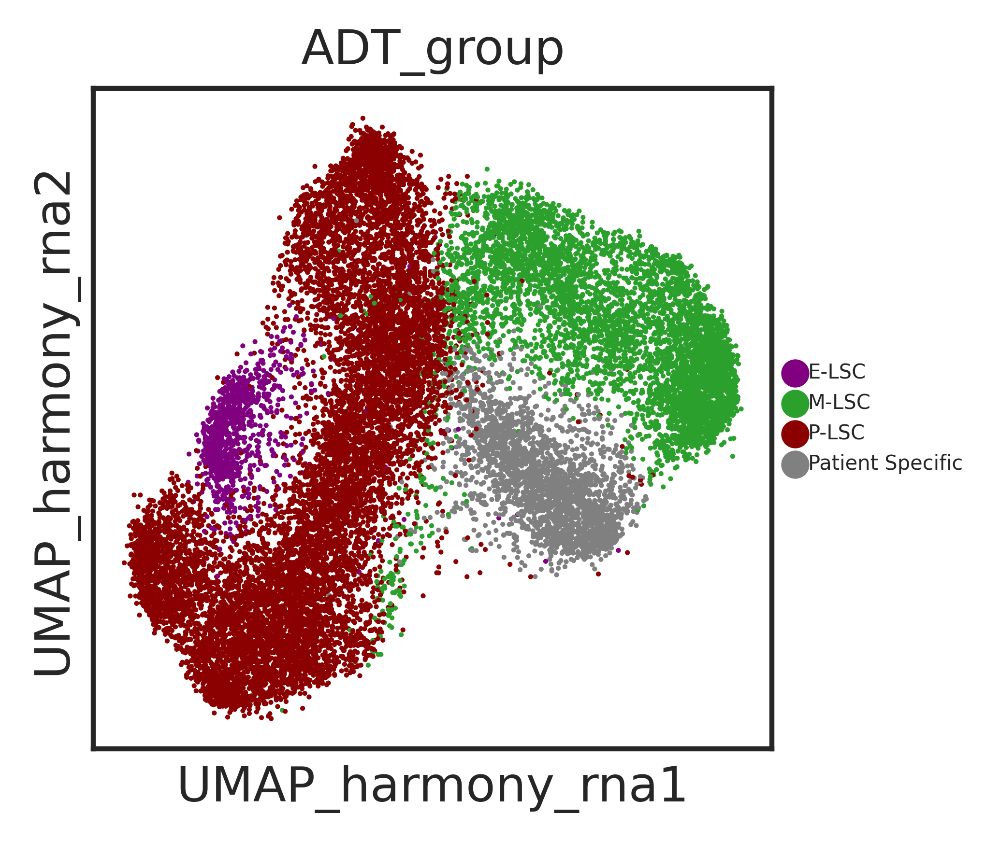

In [8]:
with rc_context({'figure.figsize': (3, 3)}):

    sc.pl.embedding(stem_like["rna"], color= ["ADT_group"], basis = "UMAP_harmony_rna",palette = LSC_colors,
                 legend_fontsize = 5,legend_fontweight = "medium", legend_fontoutline = 3, 
                 ncols = 2, vmin = "p5", vmax = "p99" , color_map = "RdGy_r", layer= "CLR_norm",save = "group_LSC_ref.pdf"
)

Figure saved to: /home/sina.kanannejad/An_scriptnew//new_figs/Fig_5/LSC_group_sample.pdf


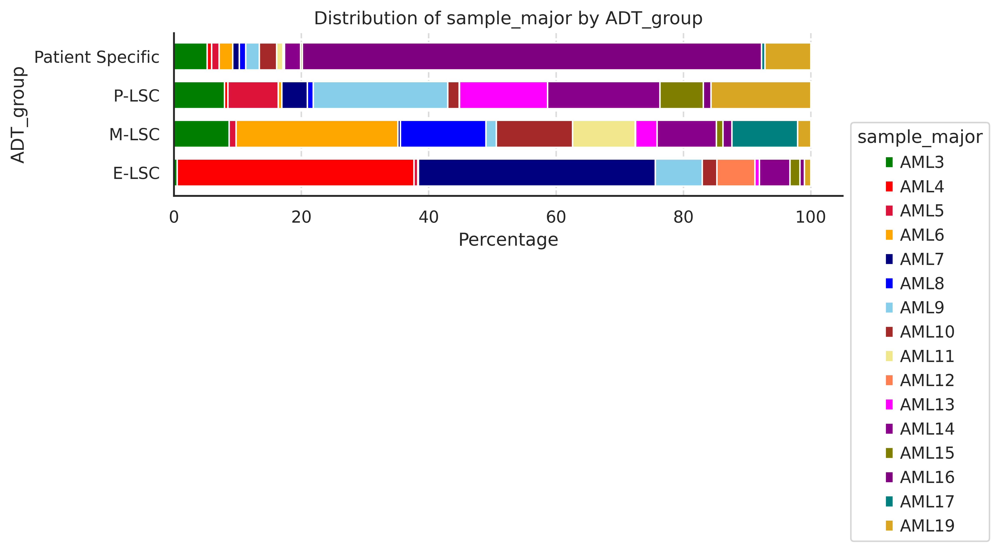

(<Figure size 2400x600 with 1 Axes>,
 <Axes: title={'center': 'Distribution of sample_major by ADT_group'}, xlabel='Percentage', ylabel='ADT_group'>)

In [37]:

plot_stacked_barplot(stem_like["rna"],
                     groupby_columns = ["ADT_group", "sample_major"],
                    color_dict = color_dict_sample_broad, figsize = (8,2), save_path = "/LSC_group_sample.pdf" )

In [38]:
adata_prot = sc.read_h5ad("/scArch_prediction.h5ad")
adata_prot.X = adata_prot.layers["raw_counts"].copy()
sc.pp.calculate_qc_metrics(adata_prot, inplace=True, percent_top=None)
def do_qc(df):
  
    return np.where((df["n_genes_by_counts"] > 14) & (df["total_counts"] > 200) &
                    (df["total_counts"] < 15000), "keep", "discard")

adata_prot.obs["QC_stat"] = do_qc(adata_prot.obs)
#sc.pl.scatter(AML_malig["adt"], y = "n_genes_by_counts", x = "total_counts",
#              color = "QC_stat", size = 10)
adata_prot = adata_prot[adata_prot.obs["QC_stat"].isin(["keep"])].copy()

In [13]:
adata_prot_stem = adata_prot[adata_prot.obs_names.isin(list(stem_like.obs_names))].copy()
adata_prot_stem.obs["ADT_group"] = stem_like["rna"].obs["ADT_group"]
adata_prot_stem.obs["leiden"] = stem_like["rna"].obs["leiden"]

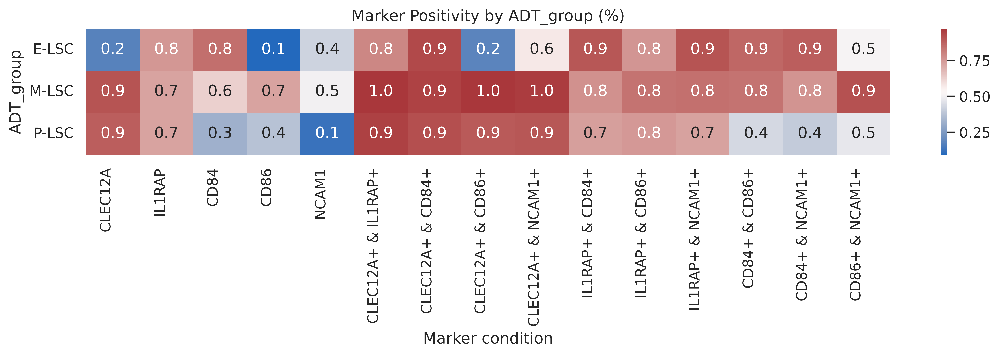

In [14]:
count_marker_combinations_heatmap(adata_prot_stem[~adata_prot_stem.obs["ADT_group"].isin(["Patient Specific"])], threshold = 1.1,
                                       gene_list = ["CLEC12A", "IL1RAP","CD84","CD86","NCAM1"],layer = "scArch_transformed_log",
                           groupby =  "ADT_group",figsize = (12,4), normalize = True, cmap = "vlag",
                                  save_path = "/LSC_group_comb.pdf")

In [15]:
group_order = [
    'AML4',
    'AML7',
    'AML12_Dx',
    'AML12_Rel',
    'AML3',
    'AML9_Dx',
    'AML13_Dx',
    'AML13_Rel',
    'AML14_Dx',
    'AML14_Rel',
    'AML15_Dx',
    'AML15_Rel',
    'AML16_Rel',
    'AML19_Dx',
    'AML19_Rel',
    'AML5',
    'AML9_Rel',
     "AML10_Dx",
    'AML10_Rel',
    'AML11_Dx',
    'AML11_Rel',
    'AML17_Rel',
     'AML6',
    'AML8',
    
]

reversed_list = group_order[::-1]
reversed_list

['AML8',
 'AML6',
 'AML17_Rel',
 'AML11_Rel',
 'AML11_Dx',
 'AML10_Rel',
 'AML10_Dx',
 'AML9_Rel',
 'AML5',
 'AML19_Rel',
 'AML19_Dx',
 'AML16_Rel',
 'AML15_Rel',
 'AML15_Dx',
 'AML14_Rel',
 'AML14_Dx',
 'AML13_Rel',
 'AML13_Dx',
 'AML9_Dx',
 'AML3',
 'AML12_Rel',
 'AML12_Dx',
 'AML7',
 'AML4']

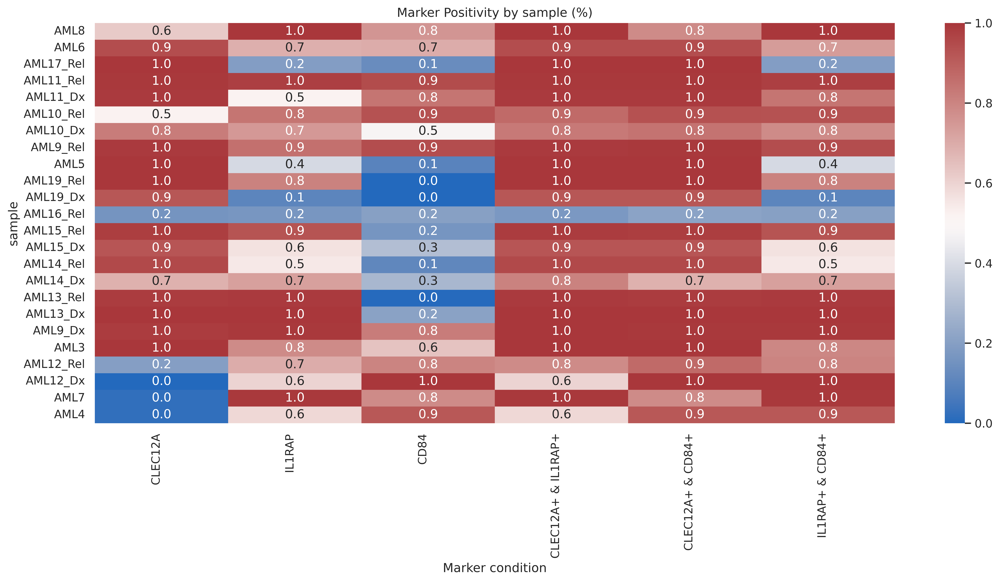

In [16]:
count_marker_combinations_heatmap(adata_prot_stem[~adata_prot_stem.obs["ADT_group"].isin(["Patient Specific"])], threshold = 1.1,
                                       gene_list = ["CLEC12A", "IL1RAP","CD84"],layer = "scArch_transformed_log",
                           groupby =  "sample",figsize = (15,8), normalize = True, cmap = "vlag",category_order = reversed_list,
                                  save_path = "/sample_comb.pdf")

Figure saved to: /home/sina.kanannejad/An_scriptnew/new_figs/Fig_5/sample_bar_cyto.pdf


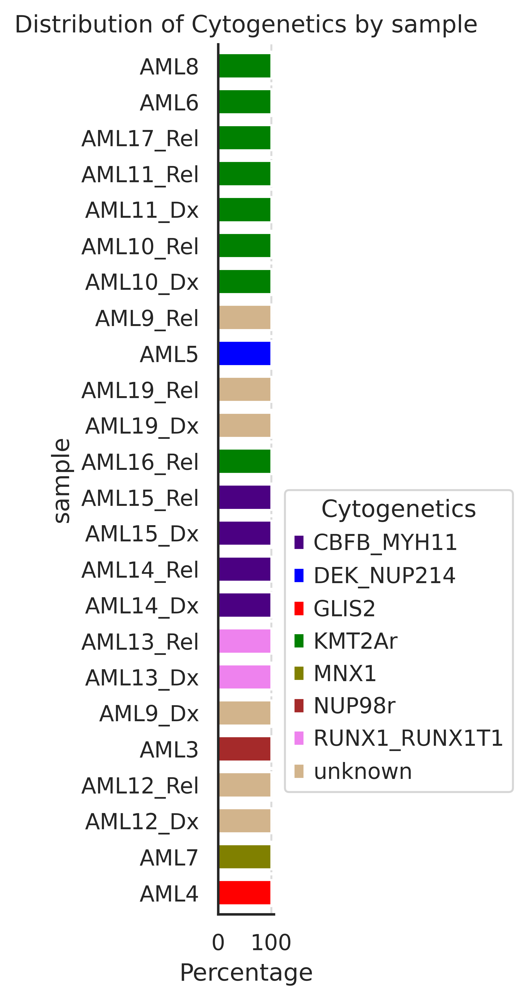

(<Figure size 150x2400 with 1 Axes>,
 <Axes: title={'center': 'Distribution of Cytogenetics by sample'}, xlabel='Percentage', ylabel='sample'>)

In [19]:

plot_stacked_barplot(stem_like["rna"][~stem_like["rna"].obs["ADT_group"].isin(["Patient Specific"])],
                     groupby_columns = ["sample", "Cytogenetics"],group_order = group_order,
                    color_dict = color_dict_cyto, figsize = (0.5,8), 
                    save_path =  "/sample_bar_cyto.pdf")

Figure saved to: /home/sina.kanannejad/An_scriptnew//new_figs/Fig_5/sample_bar_LSC_enrich.pdf


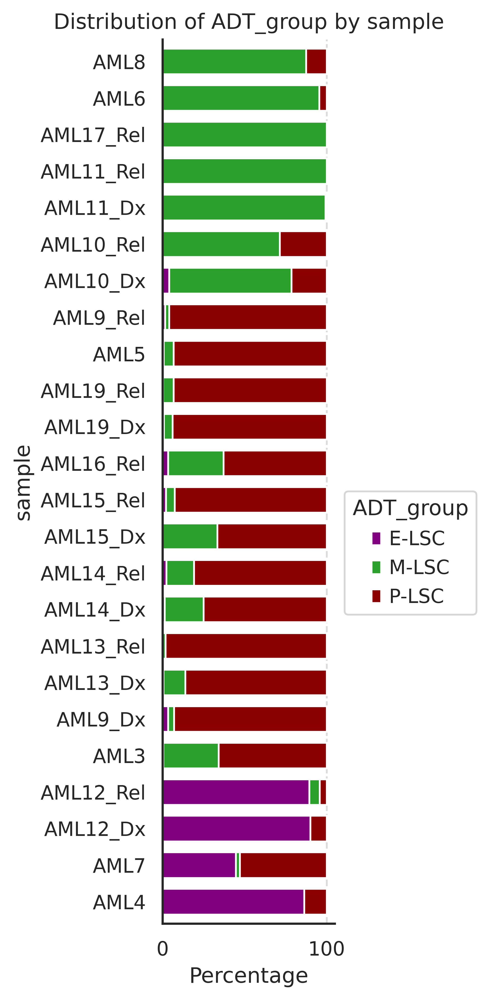

(<Figure size 1200x2400 with 1 Axes>,
 <Axes: title={'center': 'Distribution of ADT_group by sample'}, xlabel='Percentage', ylabel='sample'>)

In [20]:

plot_stacked_barplot(stem_like["rna"][~stem_like["rna"].obs["ADT_group"].isin(["Patient Specific"])],
                     groupby_columns = ["sample", "ADT_group"],group_order = group_order,
                    color_dict = LSC_colors, figsize = (4,8),
                    save_path =  "/sample_bar_LSC_enrich.pdf")

# Extended

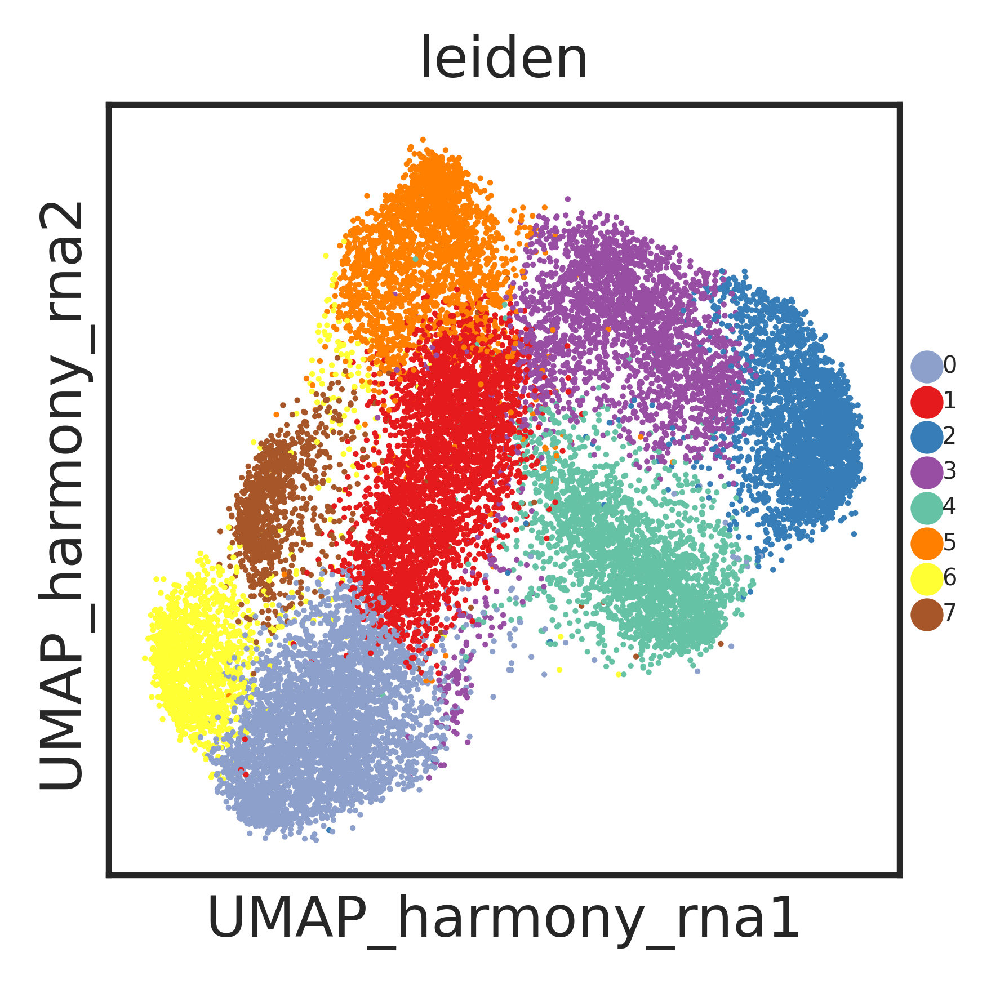

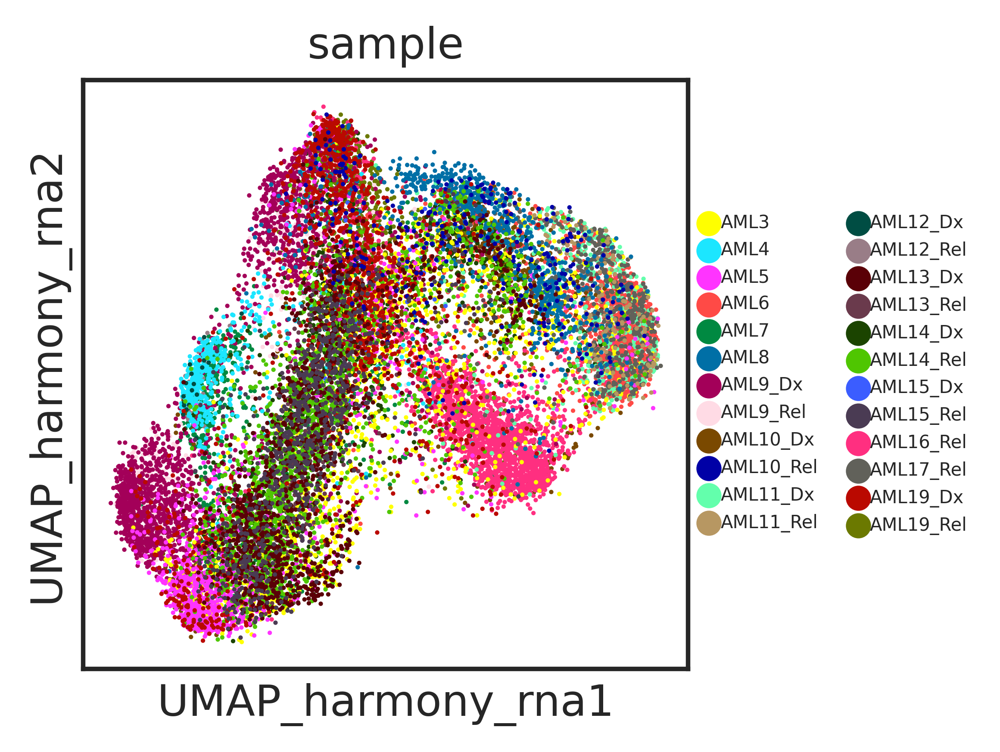

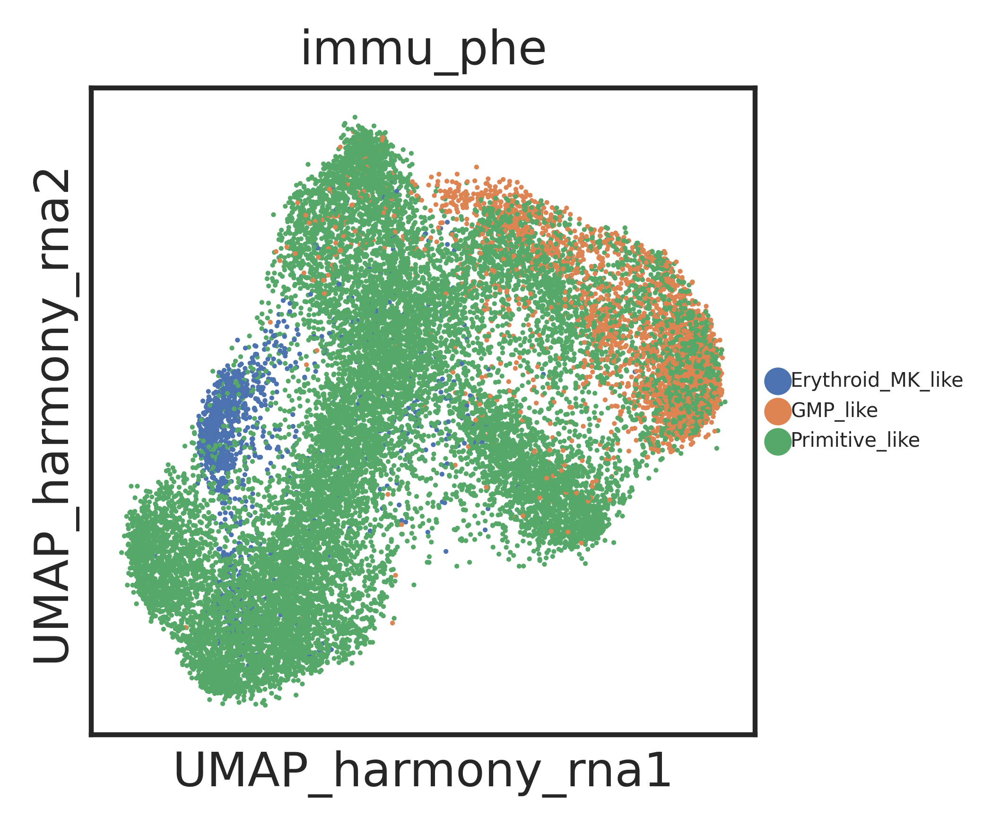

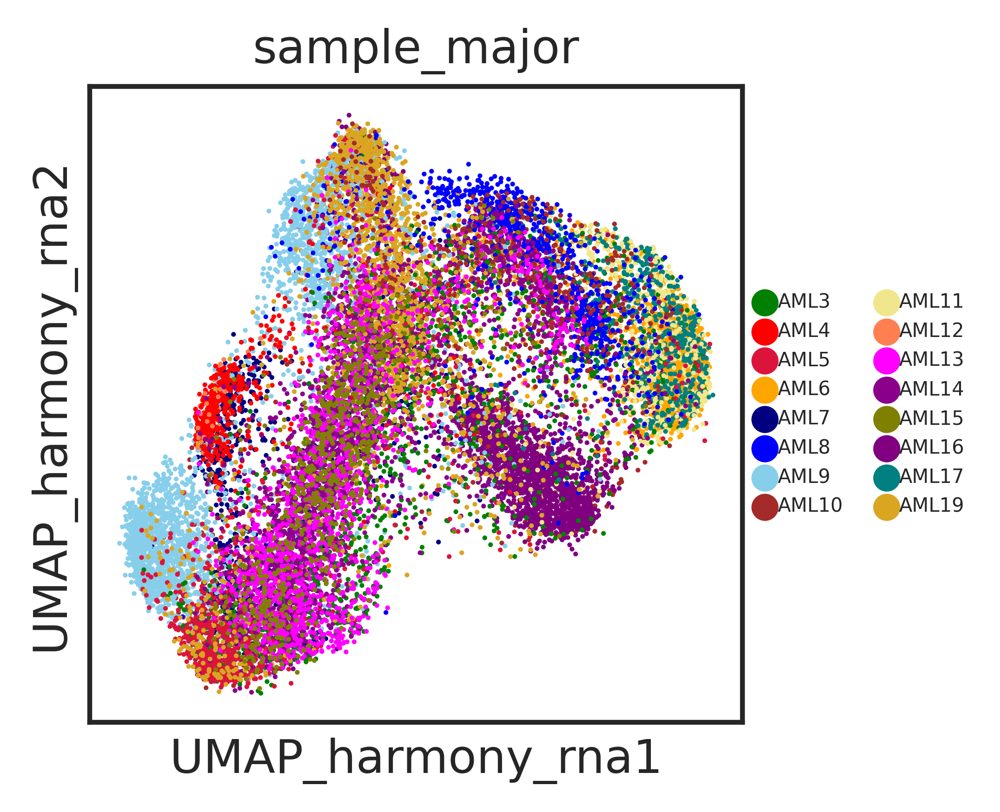

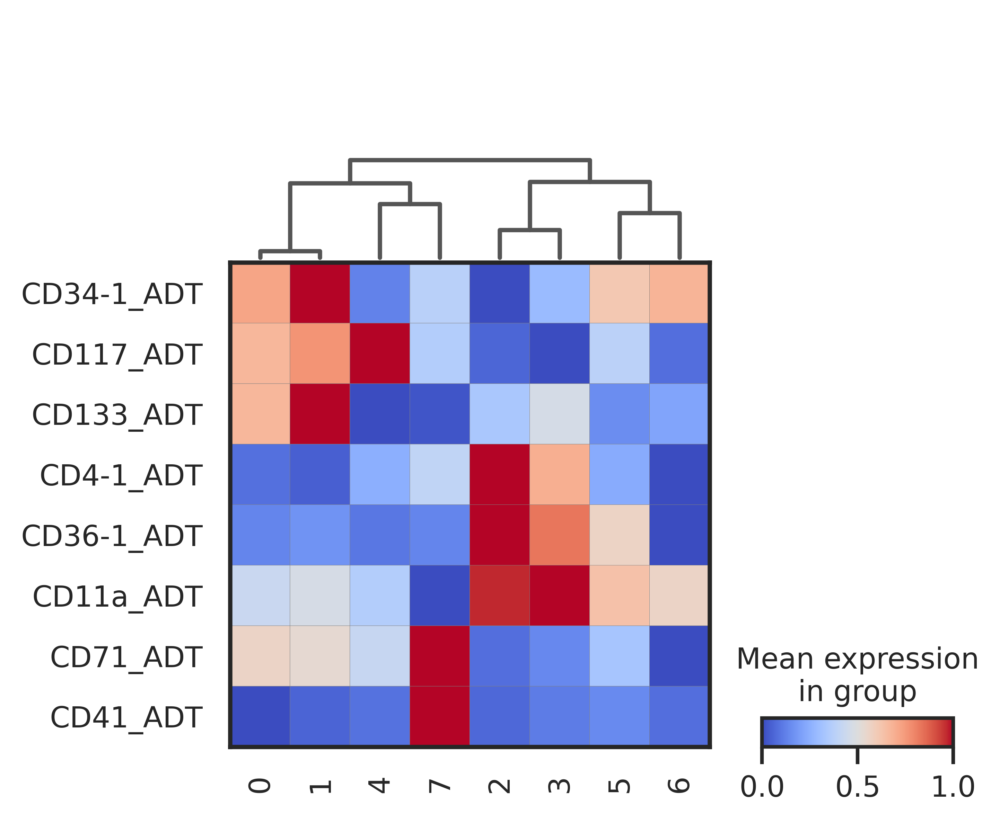

In [21]:
with rc_context({'figure.figsize': (3, 3)}):

    sc.pl.embedding(stem_like["rna"], color= ["leiden"], basis = "UMAP_harmony_rna",palette = leiden_COLORS,
                 legend_fontsize = 5,legend_fontweight = "medium", legend_fontoutline = 3, 
                 ncols = 2, vmin = "p5", vmax = "p99" , color_map = "RdGy_r", layer= "CLR_norm",save = "leiden_LSC_ref.pdf"
)
    
with rc_context({'figure.figsize': (3, 3)}):

    sc.pl.embedding(stem_like["rna"], color= ["sample"], basis = "UMAP_harmony_rna",
                 legend_fontsize = 5,legend_fontweight = "medium", legend_fontoutline = 3, 
                 ncols = 2, vmin = "p5", vmax = "p99" , color_map = "RdGy_r", layer= "CLR_norm",save = "Sample_minor_LSC_ref.pdf"
)

with rc_context({'figure.figsize': (3, 3)}):

    sc.pl.embedding(stem_like["rna"], color= ["immu_phe"], basis = "UMAP_harmony_rna",
                 legend_fontsize = 5,legend_fontweight = "medium", legend_fontoutline = 3, 
                 ncols = 2, vmin = "p5", vmax = "p99" , color_map = "RdGy_r", layer= "CLR_norm", save = "Immuno_pheno_LSC_ref.pdf"
)
    
with rc_context({'figure.figsize': (3, 3)}):

    sc.pl.embedding(stem_like["rna"], color= ["sample_major"], basis = "UMAP_harmony_rna",palette = color_dict_sample_broad,
                 legend_fontsize = 5,legend_fontweight = "medium", legend_fontoutline = 3, 
                 ncols = 2, vmin = "p5", vmax = "p99" , color_map = "RdGy_r", layer= "CLR_norm",save = "Sample_major_LSC_ref.pdf"
)

sc.pl.matrixplot(stem_like["adt"],swap_axes = True, var_names = ["CD34-1_ADT","CD117_ADT","CD133_ADT",
                                             "CD4-1_ADT","CD36-1_ADT","CD11a_ADT",
                                             "CD71_ADT","CD41_ADT"
], dendrogram = True,
              groupby = "leiden",cmap = "coolwarm",standard_scale = "var", save = "markers_LSC_ref.pdf")

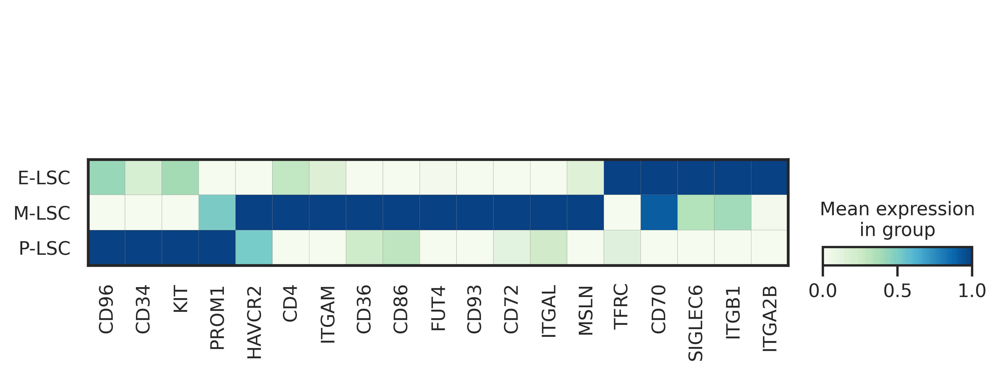

In [22]:
sc.pl.matrixplot(adata_prot_stem[~adata_prot_stem.obs["ADT_group"].isin(["Patient Specific"])],
                 var_names = ["CD96","CD34","KIT","PROM1","HAVCR2",
                                             "CD4","ITGAM","CD36","CD86","FUT4","CD93","CD72","ITGAL","MSLN",
                                             "TFRC","CD70","SIGLEC6","ITGB1","ITGA2B"
                                             ], groupby = "ADT_group",
              layer ="scArch_transformed", standard_scale ="var", cmap="GnBu", save = "LSC_like_adt_markers.pdf")

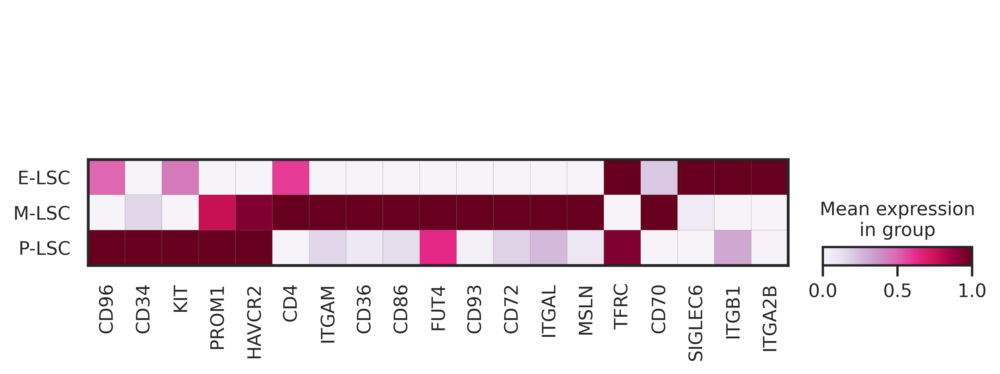

In [23]:
sc.pl.matrixplot(stem_like["rna"][~stem_like["rna"].obs["ADT_group"].isin(["Patient Specific"])],
                 var_names = ["CD96","CD34","KIT","PROM1","HAVCR2",
                                             "CD4","ITGAM","CD36","CD86","FUT4","CD93","CD72","ITGAL","MSLN",
                                             "TFRC","CD70","SIGLEC6","ITGB1","ITGA2B"
                                             ], groupby = "ADT_group",
              layer ="lognorm_counts", standard_scale ="var", cmap="PuRd", save = "LSC_like_rna_markers.pdf")

## FIG 6

In [40]:
sns.set_style("white")

Las = sc.read_h5ad("/Las_RNA.h5ad")
Las_malig = Las[Las.obs["preds_malig_normal"].isin(["Malignant"])].copy()

#del Las
stem_like_Las = Las_malig[Las_malig.obs["cluster_annotation"] == "Stem_like_shared"].copy()
stem_like_Las

AML052 = stem_like_Las[stem_like_Las.obs["sample_demult_new"].isin(["AML052"])].copy()
AML048 = stem_like_Las[stem_like_Las.obs["sample_demult_new"].isin(["AML-048"])].copy()
AML025 = stem_like_Las[stem_like_Las.obs["sample_demult_new"].isin(["AML025"])].copy()
tol = sc.concat([AML052,AML048,AML025])

Figure saved to: /home/sina.kanannejad/An_scriptnew/new_figs/Fig_5_6/AML052.pdf
Figure saved to: /home/sina.kanannejad/An_scriptnew/new_figs/Fig_5_6/AML048.pdf
Figure saved to: /home/sina.kanannejad/An_scriptnew/new_figs/Fig_5_6/AML025.pdf


,UMAP1,UMAP2,label,similarity
TCGCACTAGTAGGTTA-1_SRR16208940,2.146357,6.328209,P-LSC,0.02
TCGTGGGGTCTTCATT-1_SRR16208940,0.779124,3.615233,P-LSC,0.02
TTCCGGTCAAATACAG-1_SRR16208939,1.054705,5.851326,P-LSC,0.02
TTTACGTCAGTAGAAT-1_SRR16208940,1.000033,5.334102,P-LSC,0.02
GTCTCACGTTGGGTAG-1_SRR16208940,1.209822,3.779305,P-LSC,0.02
...,...,...,...,...
TCATCATTCCCGAAAT-1_SRR16208940,2.096233,6.397415,P-LSC,0.02
TCAGTGACAACGGGTA-1_SRR16208940,0.553878,4.292177,P-LSC,0.02
CAGCCAGAGATTGCGG-1_SRR16208940,1.086673,5.411335,P-LSC,0.02
ACCTGAACATGGTGGA-1_SRR16208940,2.138510,6.195572,P-LSC,0.02


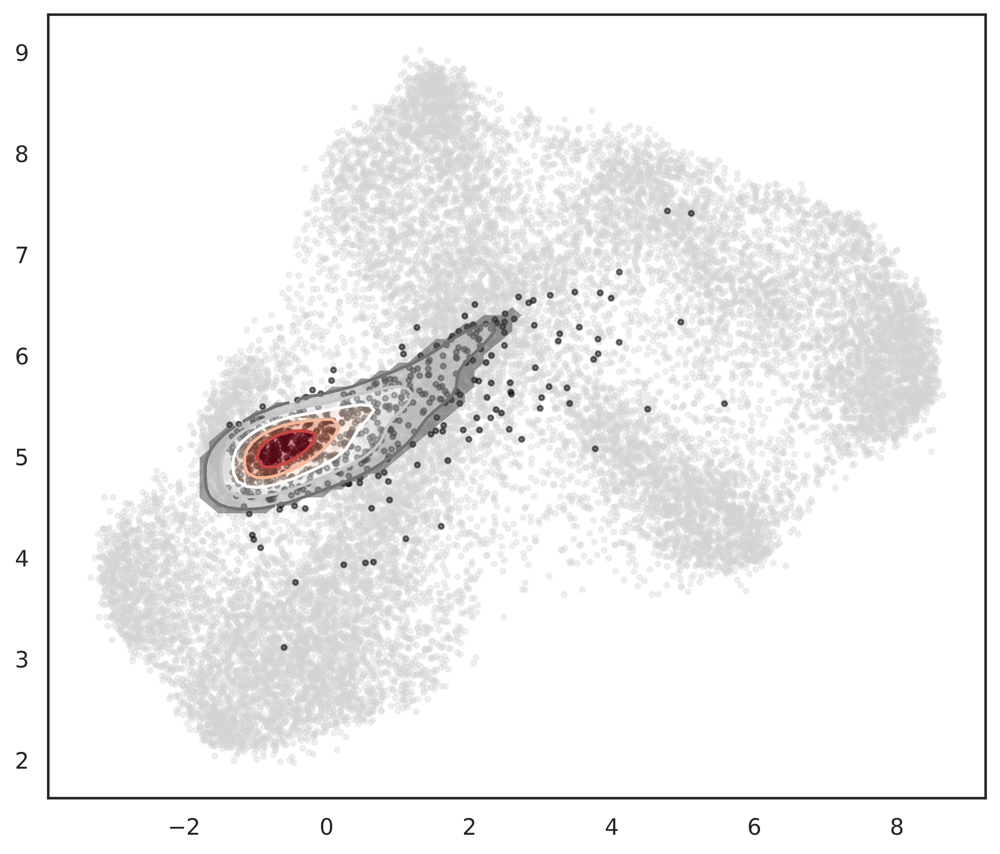

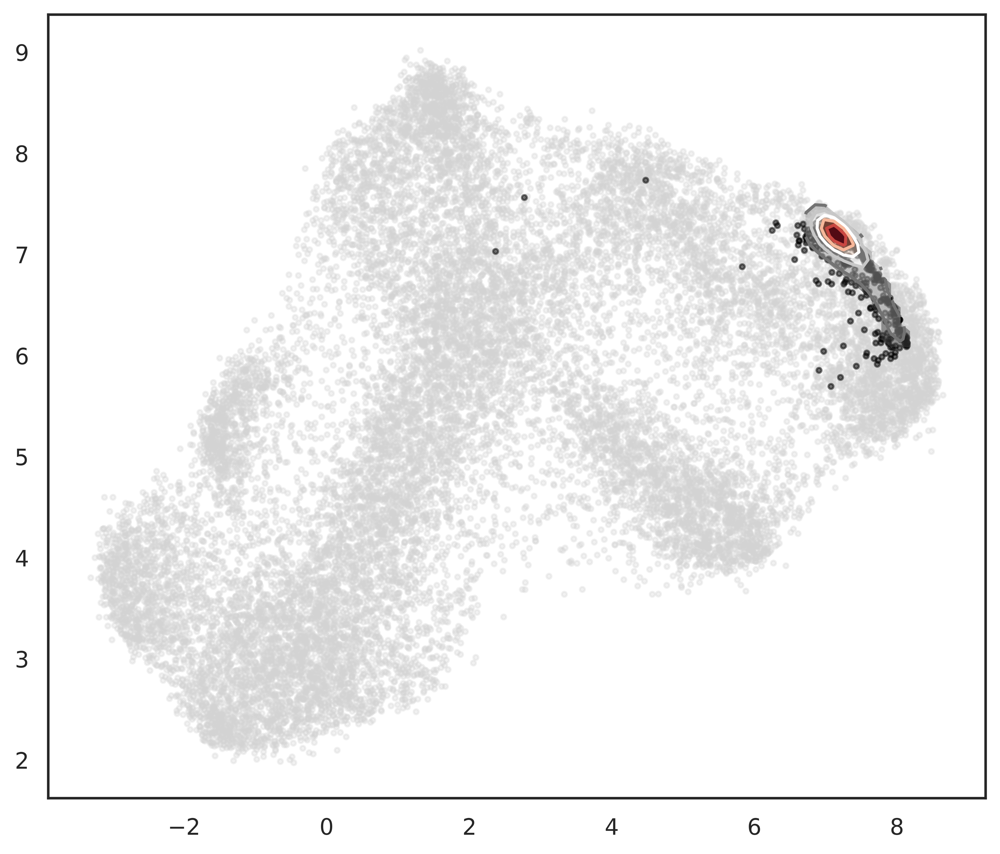

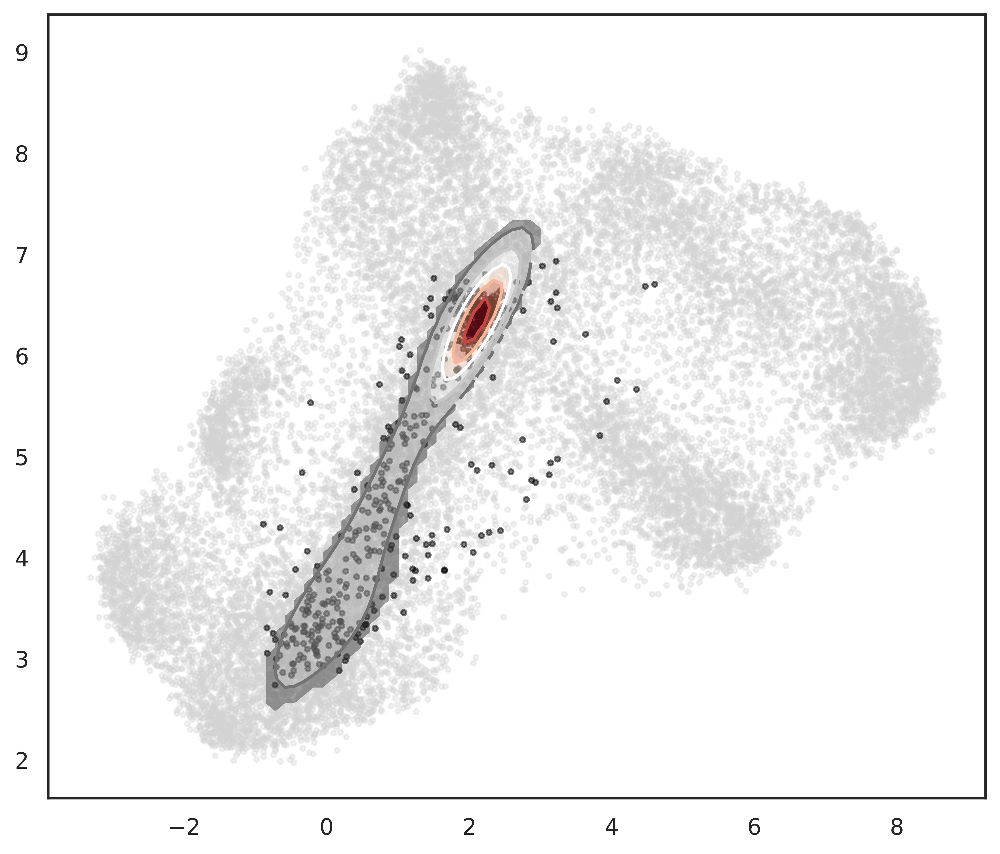

In [47]:
project_query_with_contours(new_obj, AML052, ref_label_col="ADT_group",
                                        save_path= "/Fig_5_6/AML052.pdf")

project_query_with_contours(new_obj, AML048, ref_label_col="ADT_group",
                                       save_path= "/Fig_5_6/AML048.pdf")
project_query_with_contours(new_obj, AML025, ref_label_col="ADT_group",
                                       save_path= "/AML025.pdf")

In [53]:
dir = "/test_scV2_2M_20250528_FT_5ep_LasryTst/"
preds_las = pd.read_csv(dir + "y_pred1.tsv", sep = "\t", index_col = 0)
pred_adata = ad.AnnData(preds_las)
pred_adata.obs.index = Las.obs.index
pred_adata.layers["scTrans"] = pred_adata.X.copy()
pred_adata.obs["label"] = df["label"]
pred_adata.obs["sample_demult_new"] = Las_malig.obs["sample_demult_new"]
pred_adata.obsm["X_umap"] = Las.obsm["X_umap"]

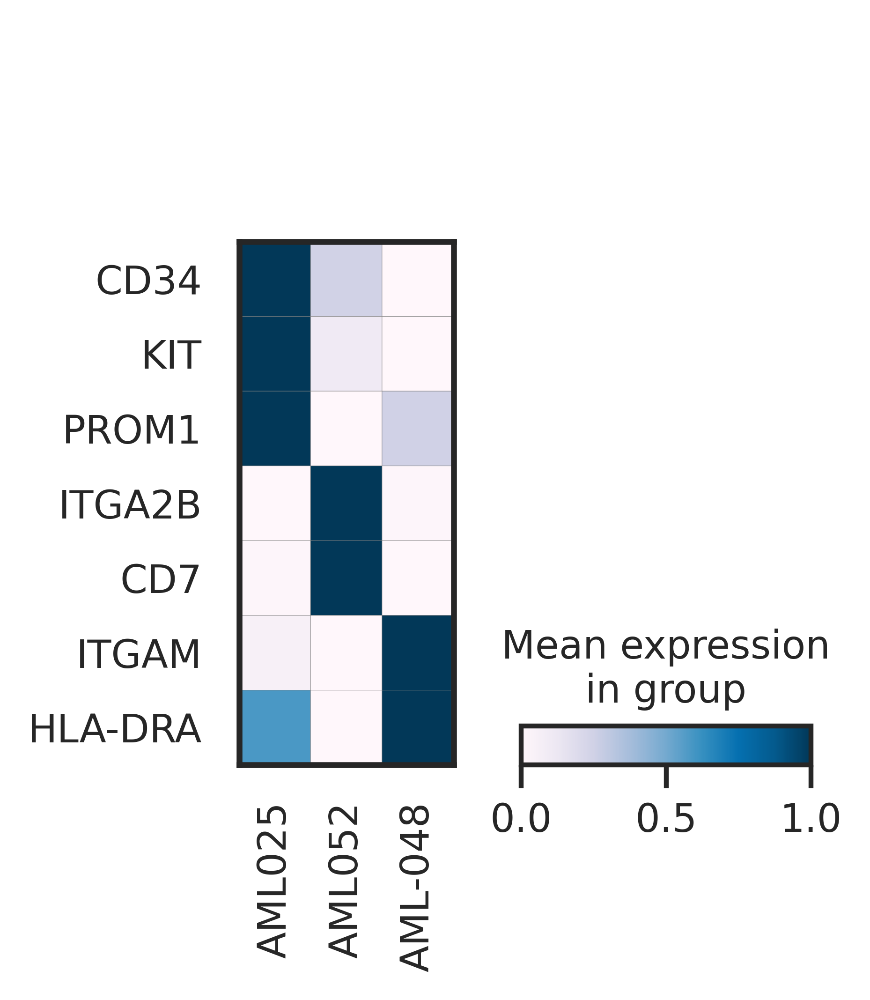

In [59]:
stem_like_Las.obs["Imputed_ADT"] = df["label"]
dp = sc.pl.matrixplot(pred_adata[pred_adata.obs["sample_demult_new"].isin(["AML052","AML-048","AML025"])],groupby = "sample_demult_new",cmap = "PuBu",
             var_names = ["CD34","KIT","PROM1","ITGA2B","CD7","ITGAM","HLA-DRA"], standard_scale = "var", swap_axes  = True,
                     save = "scTrans_markers.pdf")

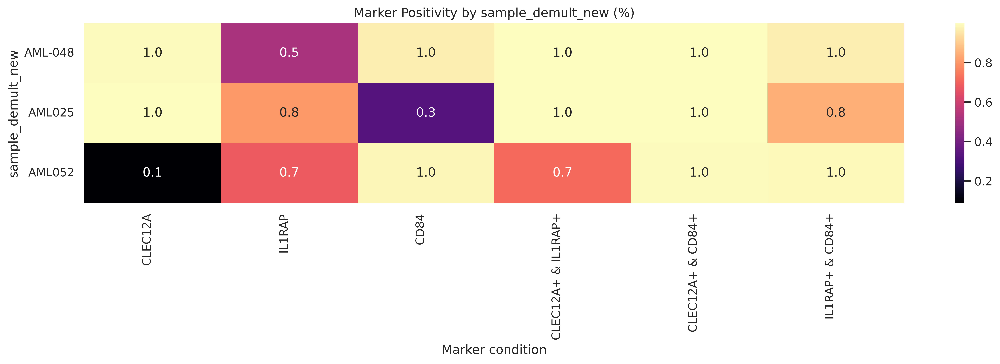

In [56]:
count_marker_combinations_heatmap(pred_adata[pred_adata.obs["sample_demult_new"].isin(["AML052","AML-048","AML025"])], 
                                  threshold = 0.2,
                                       gene_list = ["CLEC12A", "IL1RAP","CD84"],
                                  layer = "scTrans",
                           groupby =  "sample_demult_new",figsize = (15,5), normalize = True, cmap = "magma",
                                 save_path =  "/Three_Patients_markers.pdf" )

# Supplement Figs

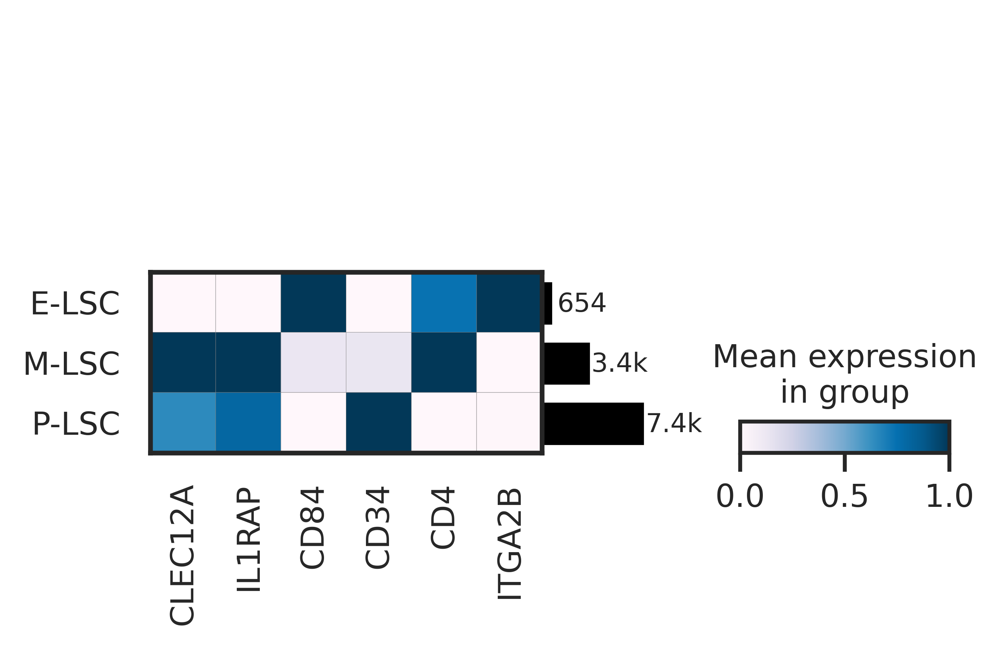

In [61]:
stem_like_Las.obs["Imputed_ADT"] = df["label"]
dp = sc.pl.matrixplot(stem_like_Las,groupby = "Imputed_ADT",cmap = "PuBu",
             var_names = ["CLEC12A","IL1RAP","CD84","CD34","CD4","ITGA2B"],standard_scale = "var",return_fig=True)
dp.add_totals(color = "black")
dp.savefig('/dotplot_LSCs_RNA.pdf', dpi=300, bbox_inches='tight', format='pdf')


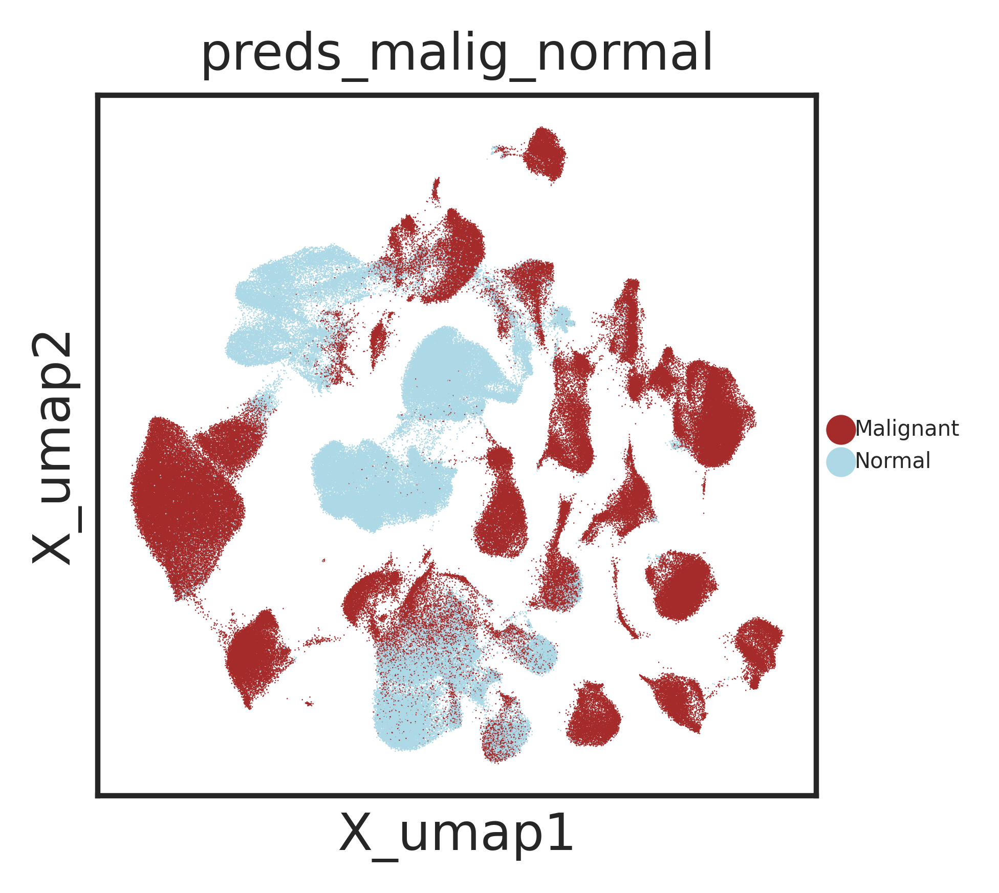

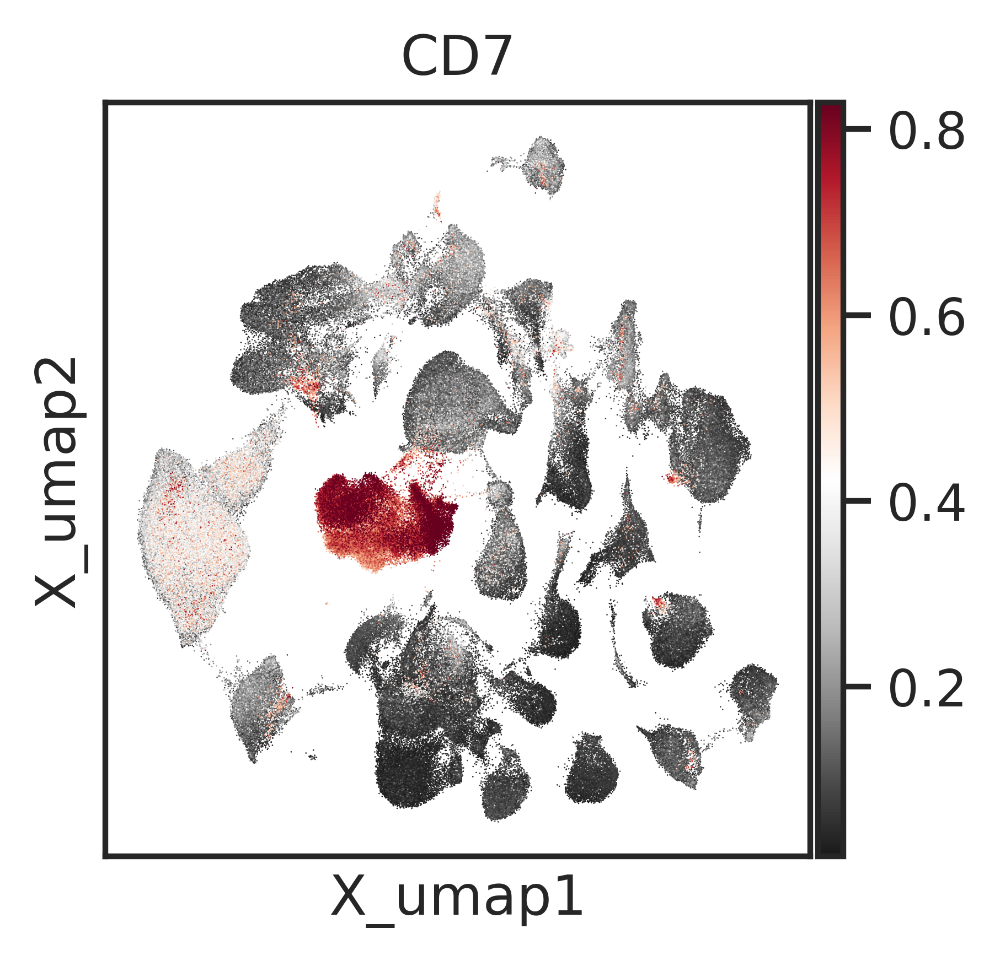

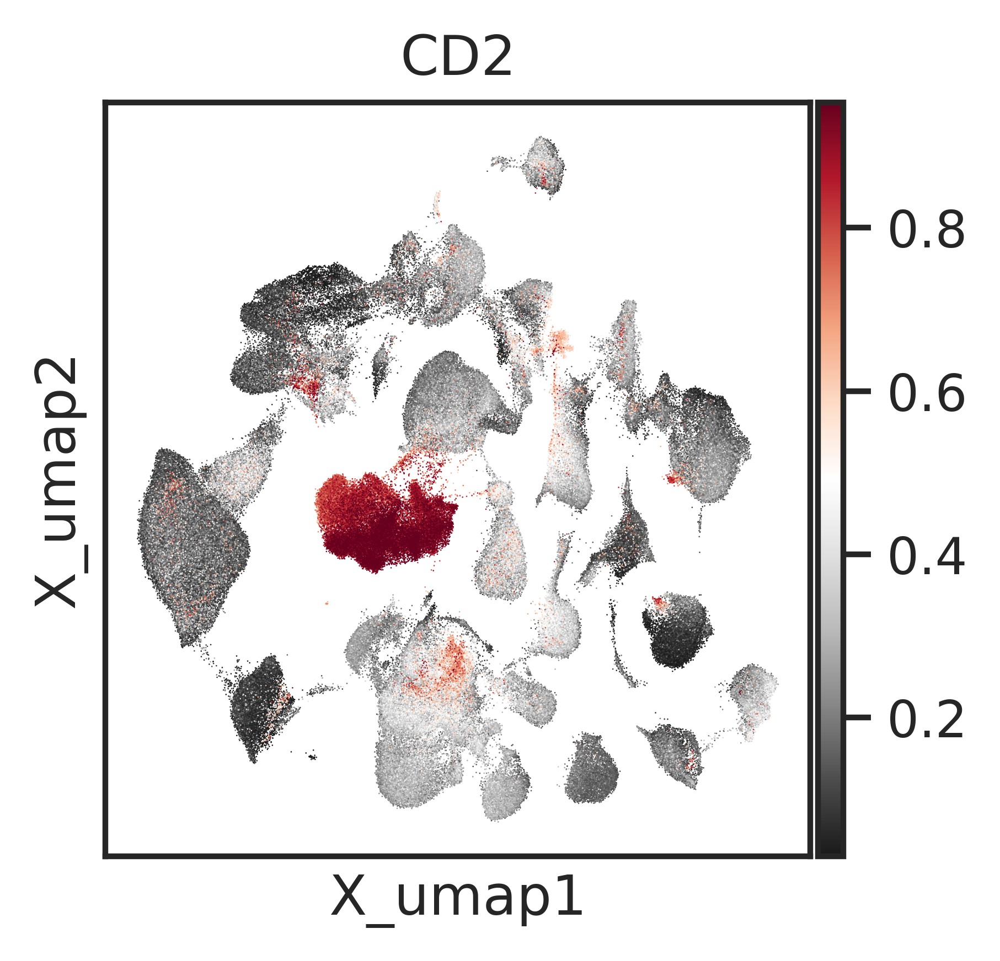

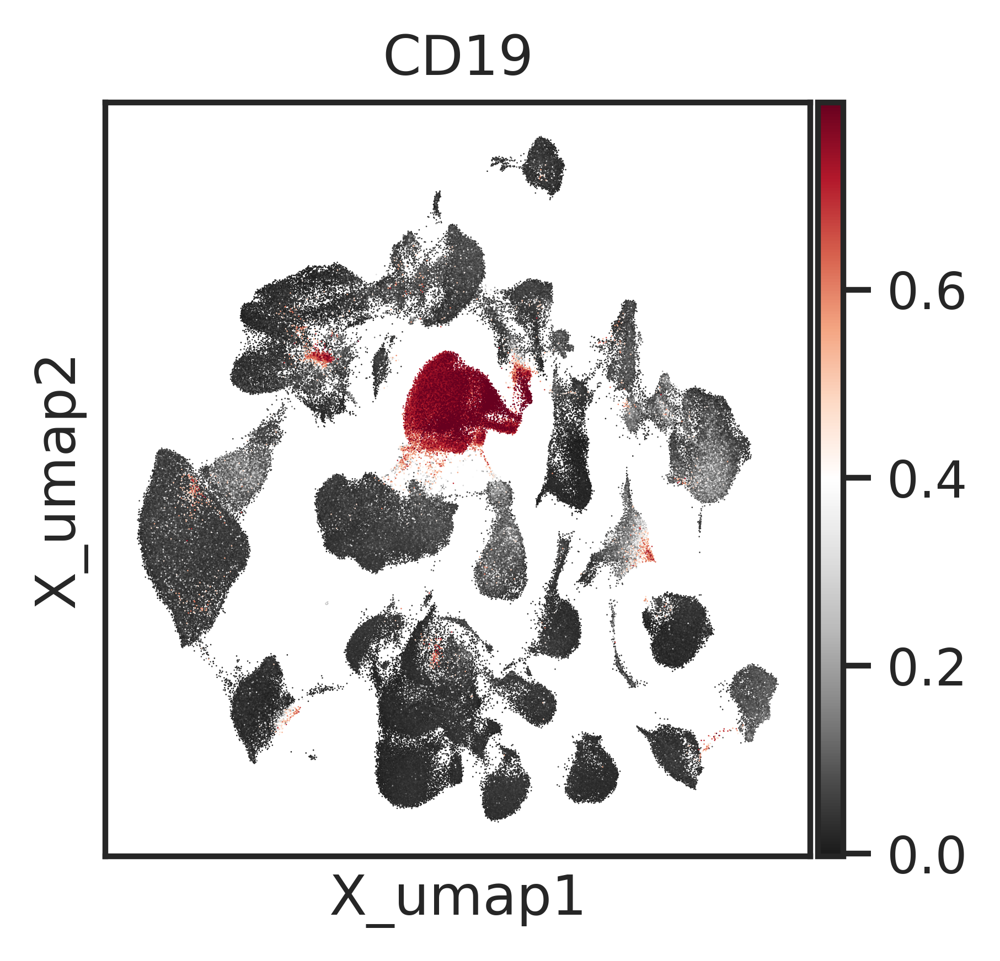

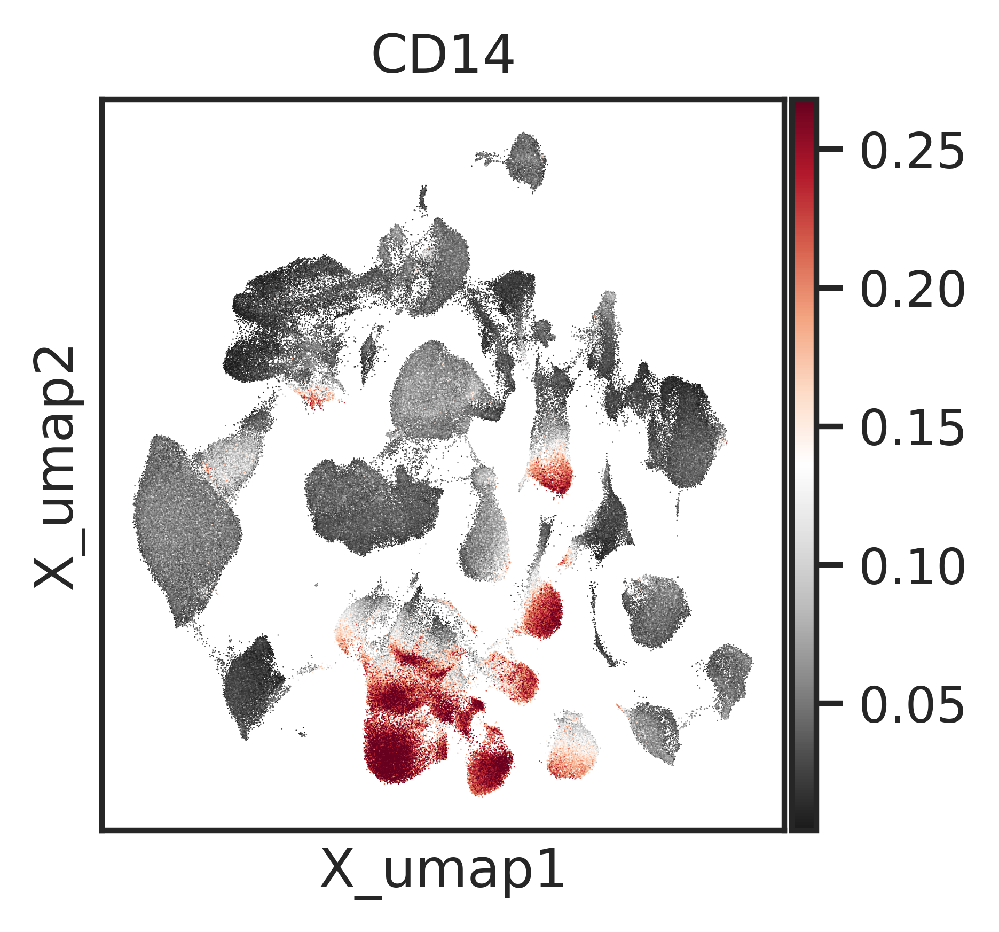

...

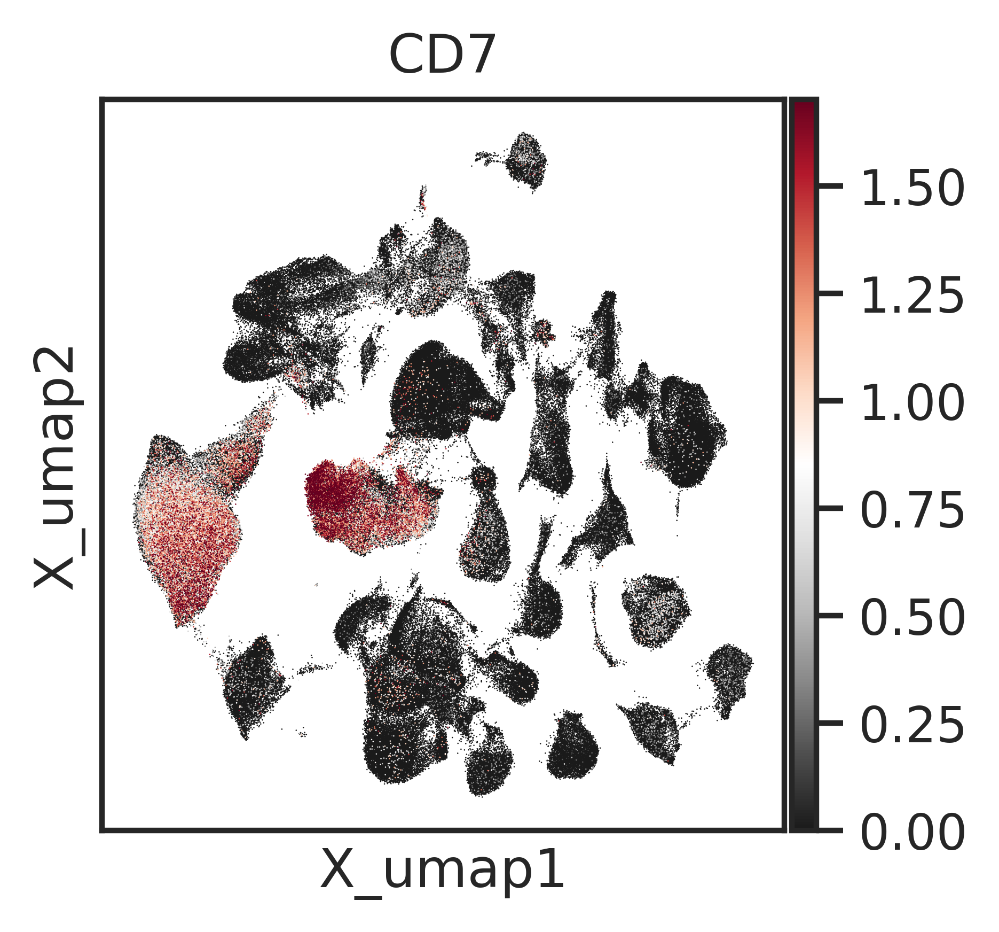

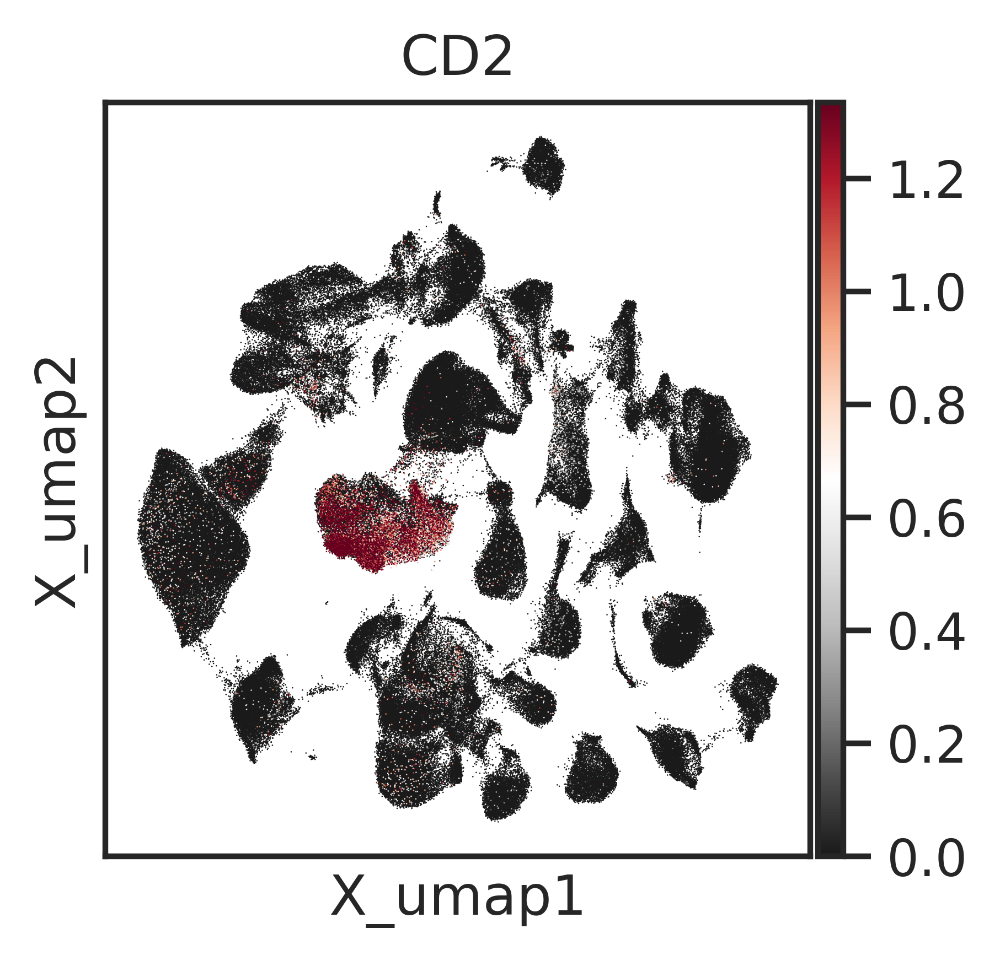

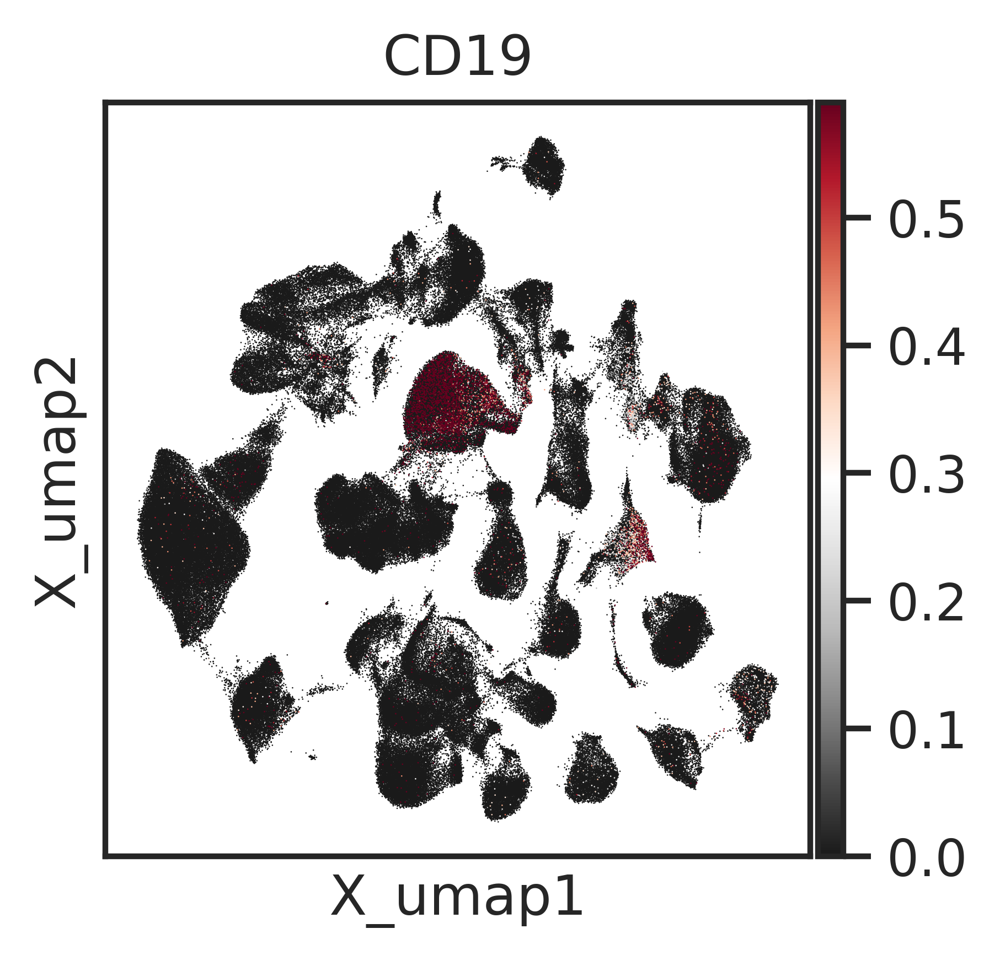

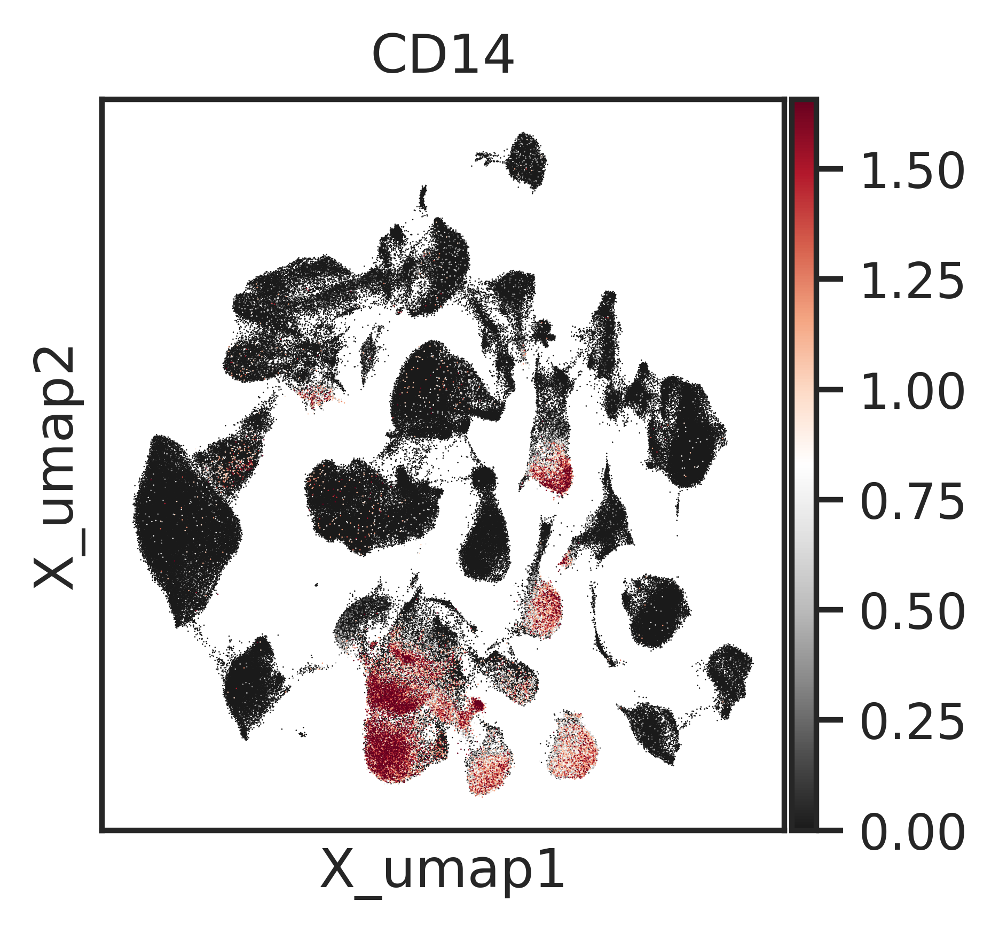

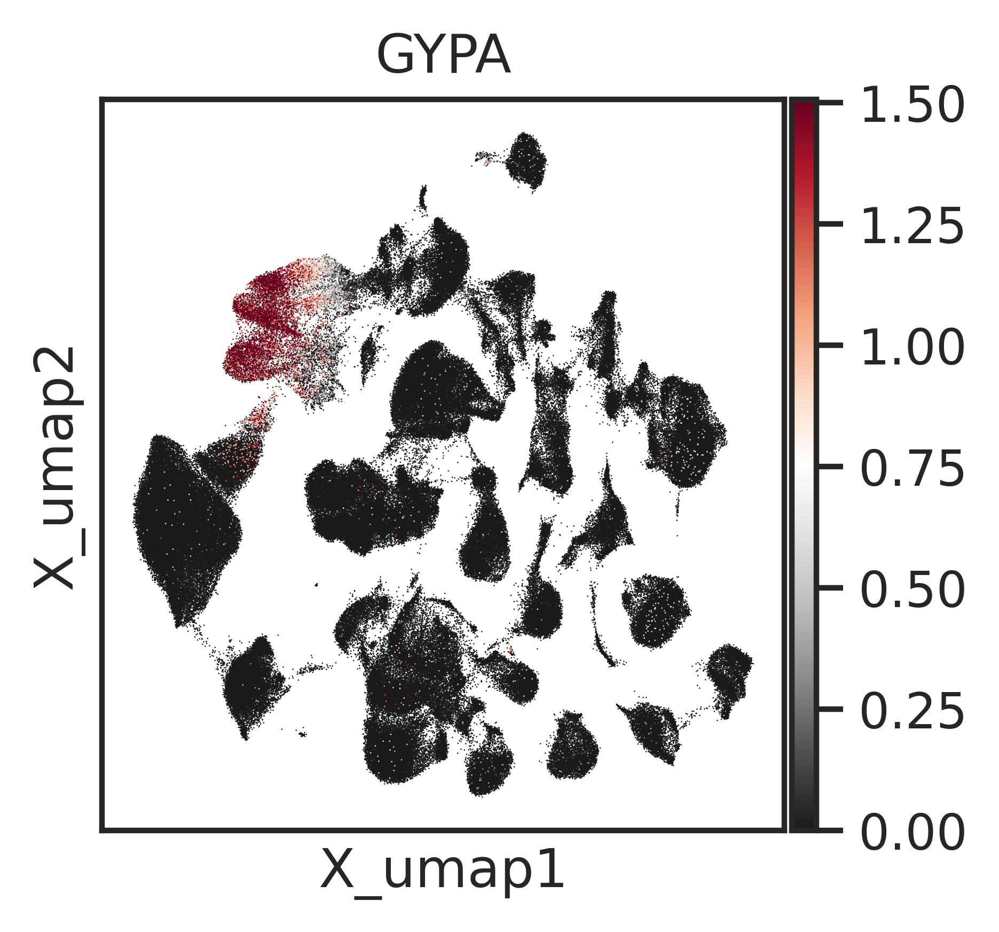

In [62]:
def batch_umap_plots(datasets):
    """
    Generates UMAP plots for multiple genes across different adata objects.
    
    Parameters
    ----------
    datasets : list of tuples
        Each tuple should be (adata, genes_list, prefix, palette).
        Example: (Las, ["CD7", "CD2"], "RNA", leiden_COLORS)
    """
    for adata, genes, prefix, palette in datasets:
        for gene in genes:
            with rc_context({'figure.figsize': (3, 3)}):
                sc.pl.embedding(
                    adata,
                    color=[gene],
                    basis="X_umap",
                    palette=palette,
                    legend_fontsize=5,
                    legend_fontweight="medium",
                    legend_fontoutline=3,
                    ncols=2,
                    vmin="p5",
                    vmax="p99",
                    color_map="RdGy_r",
                    save=f"_{gene}_{prefix}.png"
                )


datasets = [
    (Las, ["preds_malig_normal"], "Mal_normal_pred", Malignant_normal),
    (pred_adata, ["CD7", "CD2", "CD19", "CD14", "GYPA"], "pred", leiden_COLORS),
    (Las, ["CD7", "CD2", "CD19", "CD14", "GYPA"], "RNA", leiden_COLORS)
]

batch_umap_plots(datasets)

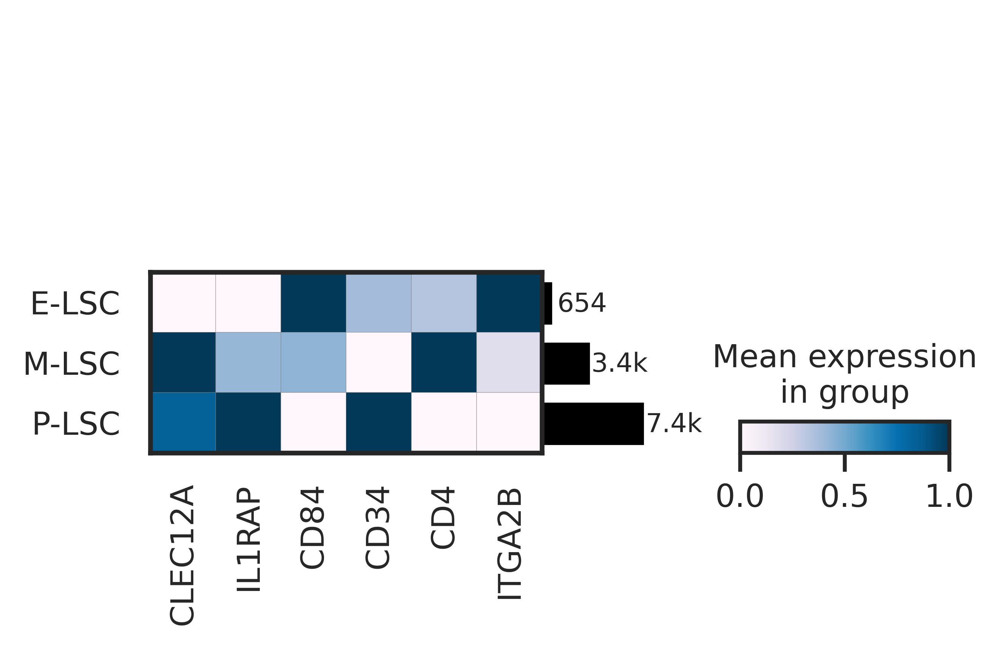

In [63]:
pred_adata.obs["Imputed_ADT"] = df["label"]
dp = sc.pl.matrixplot(pred_adata,groupby = "Imputed_ADT",cmap = "PuBu",
             var_names = ["CLEC12A","IL1RAP","CD84","CD34","CD4","ITGA2B"],standard_scale = "var",return_fig=True)
dp.add_totals(color = "black")
dp.savefig('/home/sina.kanannejad/An_scriptnew/new_figs/Fig_5_6/dotplot_LSCs_adt.png',
           dpi=300, bbox_inches='tight', format='png')


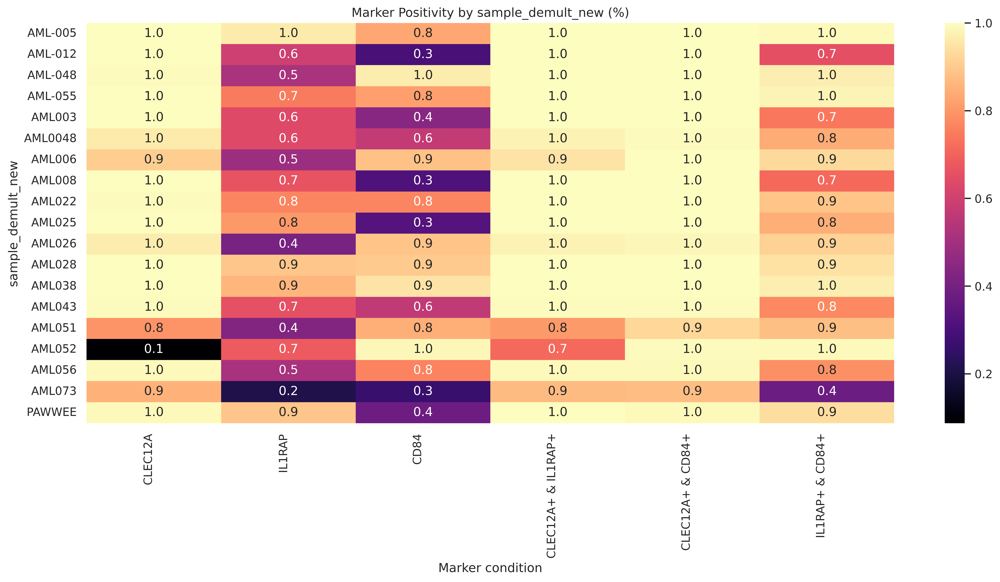

In [64]:
count_marker_combinations_heatmap(pred_adata[~pred_adata.obs['sample_demult_new'].isna()], 
                                  threshold = 0.2,
                                       gene_list = ["CLEC12A", "IL1RAP","CD84"],
                                  layer = "scTrans",
                           groupby =  "sample_demult_new",figsize = (15,8), normalize = True, cmap = "magma",
                                 save_path = "/sample_comb_Las_scTrans.pdf" )